In [1]:

import xarray as xr
import matplotlib.pyplot as plt
import matplotlib as mpl
import numpy as np
import scipy
import os
import glob as glob
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import calendar

In [2]:
mT = xr.open_dataarray('/home/z5113258/Documents/data/CMIP6/EC-Earth3/climatology/EC_dtdt.nc').sel(lat=slice(-40,30),lon=slice(30,125))
mua = xr.open_dataarray('/home/z5113258/Documents/data/CMIP6/EC-Earth3/climatology/EC_uadv.nc').sel(lat=slice(-40,30),lon=slice(30,125))
mva = xr.open_dataarray('/home/z5113258/Documents/data/CMIP6/EC-Earth3/climatology/EC_vadv.nc').sel(lat=slice(-40,30),lon=slice(30,125))
mwa = xr.open_dataarray('/home/z5113258/Documents/data/CMIP6/EC-Earth3/climatology/EC_wadv.nc').sel(lat=slice(-40,30),lon=slice(30,125))
mq = xr.open_dataarray('/home/z5113258/Documents/data/CMIP6/EC-Earth3/climatology/EC_qnet.nc').sel(lat=slice(-40,30),lon=slice(30,125))
#obs heat budget
gT = xr.open_dataarray('/home/z5113258/Documents/GODAS/remapcon_1/climatology/GODAS_dtdt.nc').sel(lat=slice(-40,30),lon=slice(30,125))
gua = xr.open_dataarray('/home/z5113258/Documents/GODAS/remapcon_1/climatology/GODAS_uadv.nc').sel(lat=slice(-40,30),lon=slice(30,125))
gva = xr.open_dataarray('/home/z5113258/Documents/GODAS/remapcon_1/climatology/GODAS_vadv.nc').sel(lat=slice(-40,30),lon=slice(30,125))
gwa = xr.open_dataarray('/home/z5113258/Documents/GODAS/remapcon_1/climatology/GODAS_wadv.nc').sel(lat=slice(-40,30),lon=slice(30,125))
gq = xr.open_dataarray('/home/z5113258/Documents/GODAS/remapcon_1/climatology/GODAS_qnet.nc').sel(lat=slice(-40,30),lon=slice(30,125))
#model compoenents advection
mdx = xr.open_dataarray('/home/z5113258/Documents/data/CMIP6/EC-Earth3/climatology/EC_dtdx.nc').sel(lat=slice(-40,30),lon=slice(30,125))
mdy = xr.open_dataarray('/home/z5113258/Documents/data/CMIP6/EC-Earth3/climatology/EC_dtdy.nc').sel(lat=slice(-40,30),lon=slice(30,125))
mdz = xr.open_dataarray('/home/z5113258/Documents/data/CMIP6/EC-Earth3/climatology/EC_dtdz.nc').sel(lat=slice(-40,30),lon=slice(30,125))
muc = xr.open_dataarray('/home/z5113258/Documents/data/CMIP6/EC-Earth3/climatology/EC_ucur.nc').sel(lat=slice(-40,30),lon=slice(30,125))
mvc = xr.open_dataarray('/home/z5113258/Documents/data/CMIP6/EC-Earth3/climatology/EC_vcur.nc').sel(lat=slice(-40,30),lon=slice(30,125))
mwc = xr.open_dataarray('/home/z5113258/Documents/data/CMIP6/EC-Earth3/climatology/EC_wcur.nc').sel(lat=slice(-40,30),lon=slice(30,125))
#godas compoents advection
gdx = xr.open_dataarray('/home/z5113258/Documents/GODAS/remapcon_1/climatology/GODAS_dtdx.nc').sel(lat=slice(-40,30),lon=slice(30,125))
gdy = xr.open_dataarray('/home/z5113258/Documents/GODAS/remapcon_1/climatology/GODAS_dtdy.nc').sel(lat=slice(-40,30),lon=slice(30,125))
gdz = xr.open_dataarray('/home/z5113258/Documents/GODAS/remapcon_1/climatology/GODAS_dtdz.nc').sel(lat=slice(-40,30),lon=slice(30,125))
guc = xr.open_dataarray('/home/z5113258/Documents/GODAS/remapcon_1/climatology/GODAS_ucur.nc').sel(lat=slice(-40,30),lon=slice(30,125))
gvc = xr.open_dataarray('/home/z5113258/Documents/GODAS/remapcon_1/climatology/GODAS_vcur.nc').sel(lat=slice(-40,30),lon=slice(30,125))
gwc = xr.open_dataarray('/home/z5113258/Documents/GODAS/remapcon_1/climatology/GODAS_wcur.nc').sel(lat=slice(-40,30),lon=slice(30,125))
#wind
#godas
#guw = xr.open_dataarray('/g/data/e14/sm2435/OBSwind_u.nc').sel(lat=slice(-40,30),lon=slice(30,125))
#gvw = xr.open_dataarray('/g/data/e14/sm2435/OBSwind_v.nc').sel(lat=slice(-40,30),lon=slice(30,125))
#Model
#muw = xr.open_dataarray('/g/data/e14/sm2435/Ewind_u.nc').sel(lat=slice(-40,30),lon=slice(30,125))
#mvw = xr.open_dataarray('/g/data/e14/sm2435/Ewind_v.nc').sel(lat=slice(-40,30),lon=slice(30,125))

In [3]:
#load in components of advection
gubtb= xr.open_dataarray('/home/z5113258/Documents/GODAS/remapcon_1/seasonal/GODAS_UbTb.nc').sel(lat=slice(-40,30),lon=slice(30,125))
gubtd= xr.open_dataarray('/home/z5113258/Documents/GODAS/remapcon_1/seasonal/GODAS_UbTd.nc').sel(lat=slice(-40,30),lon=slice(30,125))
gudtb= xr.open_dataarray('/home/z5113258/Documents/GODAS/remapcon_1/seasonal/GODAS_UdTb.nc').sel(lat=slice(-40,30),lon=slice(30,125))
gudtd= xr.open_dataarray('/home/z5113258/Documents/GODAS/remapcon_1/seasonal/GODAS_UdTd.nc').sel(lat=slice(-40,30),lon=slice(30,125))

gvbtb= xr.open_dataarray('/home/z5113258/Documents/GODAS/remapcon_1/seasonal/GODAS_VbTb.nc').sel(lat=slice(-40,30),lon=slice(30,125))
gvbtd= xr.open_dataarray('/home/z5113258/Documents/GODAS/remapcon_1/seasonal/GODAS_VbTd.nc').sel(lat=slice(-40,30),lon=slice(30,125))
gvdtb= xr.open_dataarray('/home/z5113258/Documents/GODAS/remapcon_1/seasonal/GODAS_VdTb.nc').sel(lat=slice(-40,30),lon=slice(30,125))
gvdtd= xr.open_dataarray('/home/z5113258/Documents/GODAS/remapcon_1/seasonal/GODAS_VdTd.nc').sel(lat=slice(-40,30),lon=slice(30,125))

gwbtb= xr.open_dataarray('/home/z5113258/Documents/GODAS/remapcon_1/seasonal/GODAS_WbTb.nc').sel(lat=slice(-40,30),lon=slice(30,125))
gwbtd= xr.open_dataarray('/home/z5113258/Documents/GODAS/remapcon_1/seasonal/GODAS_WbTd.nc').sel(lat=slice(-40,30),lon=slice(30,125))
gwdtb= xr.open_dataarray('/home/z5113258/Documents/GODAS/remapcon_1/seasonal/GODAS_WdTb.nc').sel(lat=slice(-40,30),lon=slice(30,125))
gwdtd= xr.open_dataarray('/home/z5113258/Documents/GODAS/remapcon_1/seasonal/GODAS_WdTd.nc').sel(lat=slice(-40,30),lon=slice(30,125))

#save these datasets
eubtb= xr.open_dataarray('/home/z5113258/Documents/data/CMIP6/EC-Earth3/seasonal/EC_UbTb.nc').sel(lat=slice(-40,30),lon=slice(30,125))
eubtd= xr.open_dataarray('/home/z5113258/Documents/data/CMIP6/EC-Earth3/seasonal/EC_UbTd.nc').sel(lat=slice(-40,30),lon=slice(30,125))
eudtb= xr.open_dataarray('/home/z5113258/Documents/data/CMIP6/EC-Earth3/seasonal/EC_UdTb.nc').sel(lat=slice(-40,30),lon=slice(30,125))
eudtd= xr.open_dataarray('/home/z5113258/Documents/data/CMIP6/EC-Earth3/seasonal/EC_UdTd.nc').sel(lat=slice(-40,30),lon=slice(30,125))

evbtb= xr.open_dataarray('/home/z5113258/Documents/data/CMIP6/EC-Earth3/seasonal/EC_VbTb.nc').sel(lat=slice(-40,30),lon=slice(30,125))
evbtd= xr.open_dataarray('/home/z5113258/Documents/data/CMIP6/EC-Earth3/seasonal/EC_VbTd.nc').sel(lat=slice(-40,30),lon=slice(30,125))
evdtb= xr.open_dataarray('/home/z5113258/Documents/data/CMIP6/EC-Earth3/seasonal/EC_VdTb.nc').sel(lat=slice(-40,30),lon=slice(30,125))
evdtd= xr.open_dataarray('/home/z5113258/Documents/data/CMIP6/EC-Earth3/seasonal/EC_VdTd.nc').sel(lat=slice(-40,30),lon=slice(30,125))

ewbtb= xr.open_dataarray('/home/z5113258/Documents/data/CMIP6/EC-Earth3/seasonal/EC_WbTb.nc').sel(lat=slice(-40,30),lon=slice(30,125))
ewbtd= xr.open_dataarray('/home/z5113258/Documents/data/CMIP6/EC-Earth3/seasonal/EC_WbTd.nc').sel(lat=slice(-40,30),lon=slice(30,125))
ewdtb= xr.open_dataarray('/home/z5113258/Documents/data/CMIP6/EC-Earth3/seasonal/EC_WdTb.nc').sel(lat=slice(-40,30),lon=slice(30,125))
ewdtd= xr.open_dataarray('/home/z5113258/Documents/data/CMIP6/EC-Earth3/seasonal/EC_WdTd.nc').sel(lat=slice(-40,30),lon=slice(30,125))

In [4]:
ddt = mT - gT
dua = mua - gua
dva = mva - gva
dwa = mwa - gwa
dq = mq - gq

ddx = mdx - gdx
ddy = mdy - gdy
ddz = mdz - gdx
duc = muc - guc
dvc = mvc - gvc
dwc = mwc - gwc

#duw = muw - guw[:,0]
#dvw = mvw - gvw[:,0]

In [5]:
lats = ddt.lat
lons = ddt.lon
#now write loop fucntion to make various plots for each mionth
def plot_background(ax, i, j):
    #for use with plotting 12 months. need to change 
    ax.set_extent([30., 125., -40., 30.])
    ax.add_feature(cfeature.COASTLINE.with_scale('50m'), linewidth=0.5)
    ax.add_feature(cfeature.LAND)
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                  linewidth=2, color='gray', alpha=0.5,)
    gl.top_labels = False
    gl.right_labels = False
    if i == 3:
        gl.bottom_labels = True
    else:
        gl.bottom_labels = False
    if j > 0:
        gl.left_labels = False
    return ax

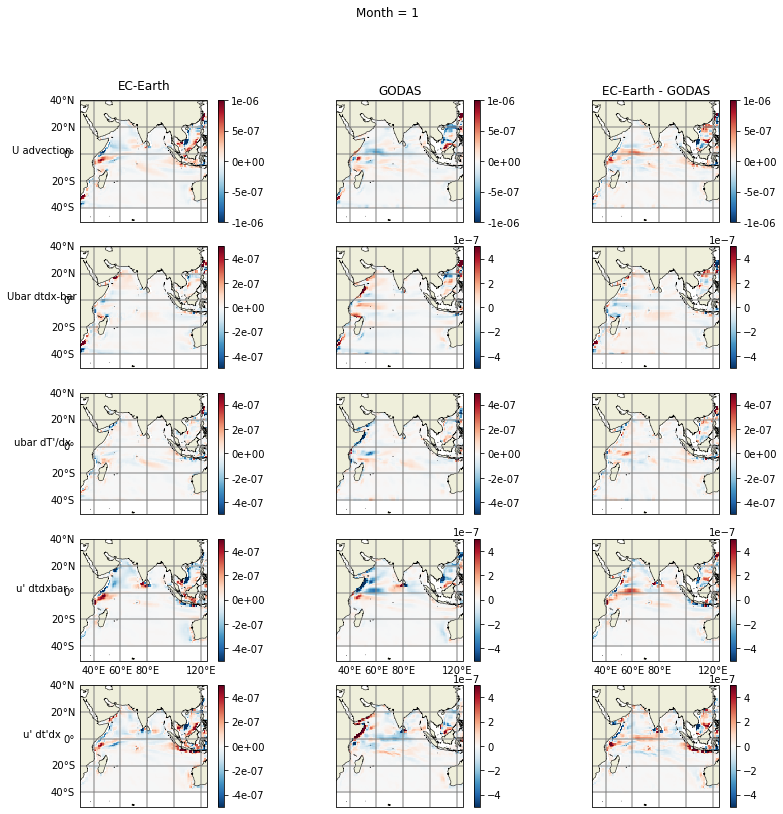

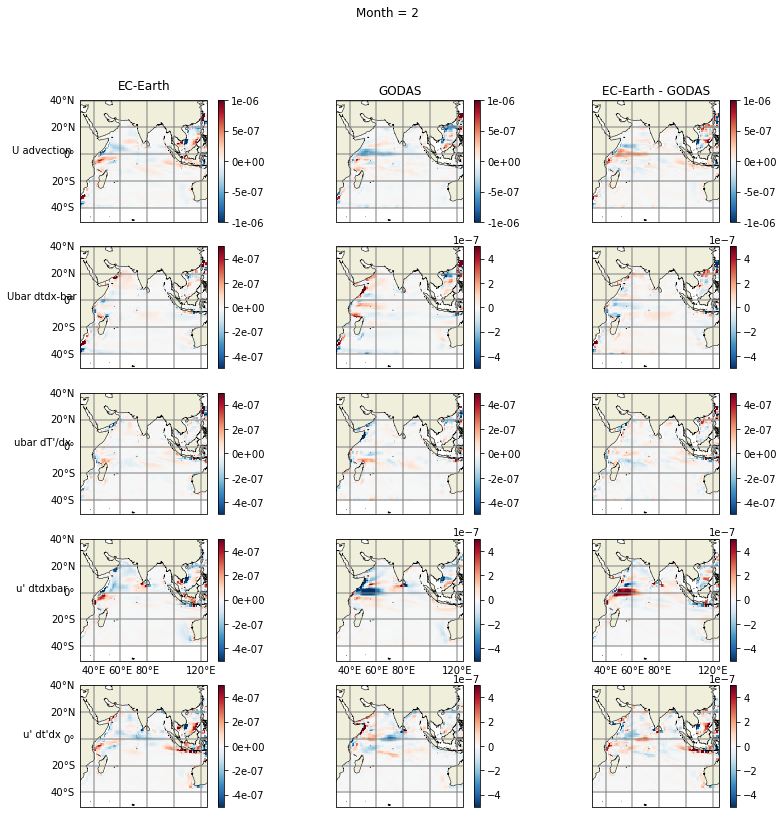

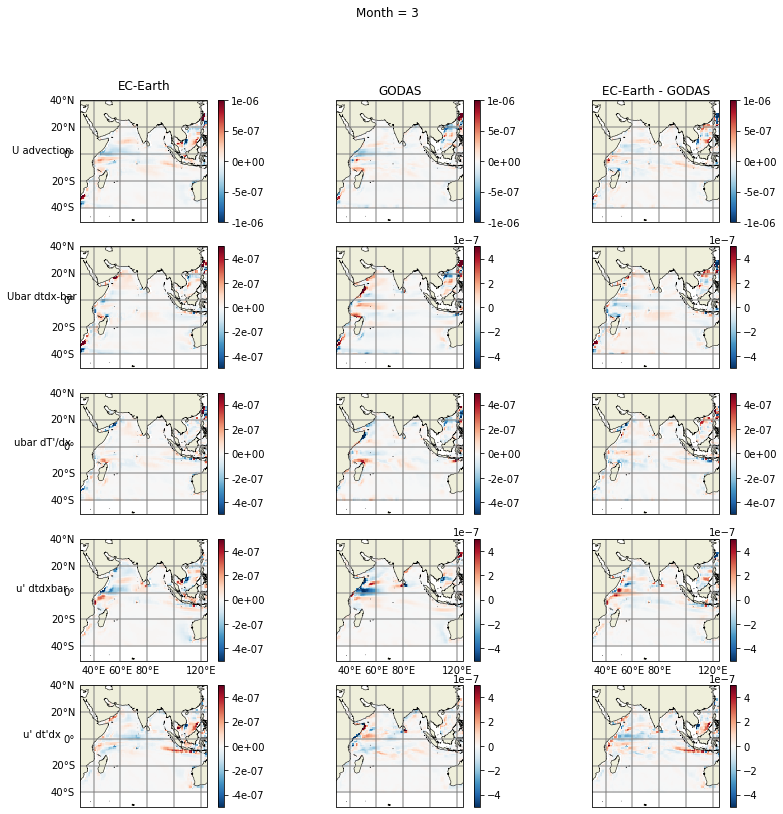

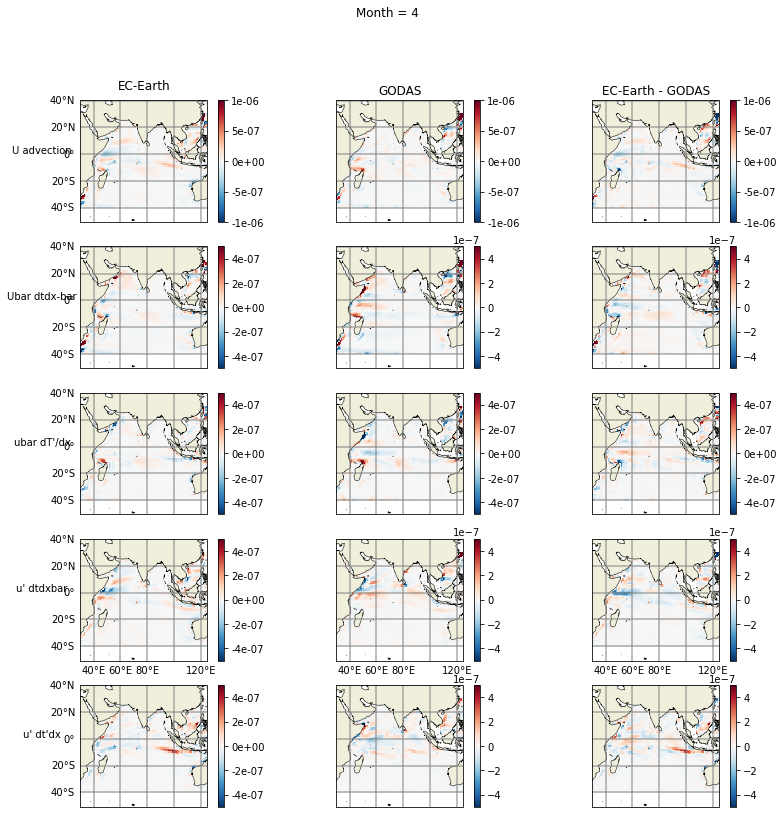

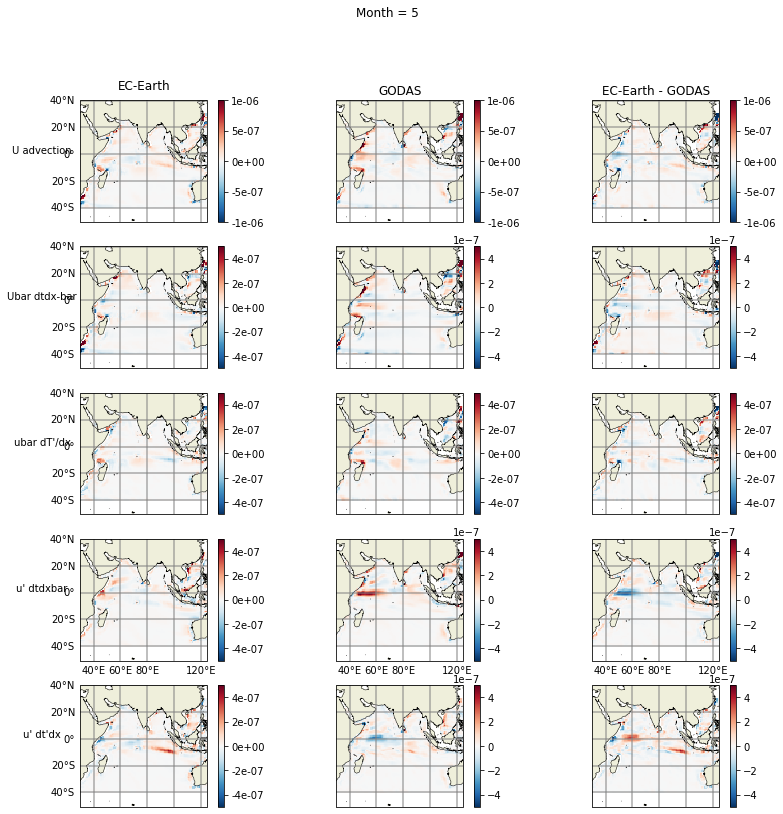

...

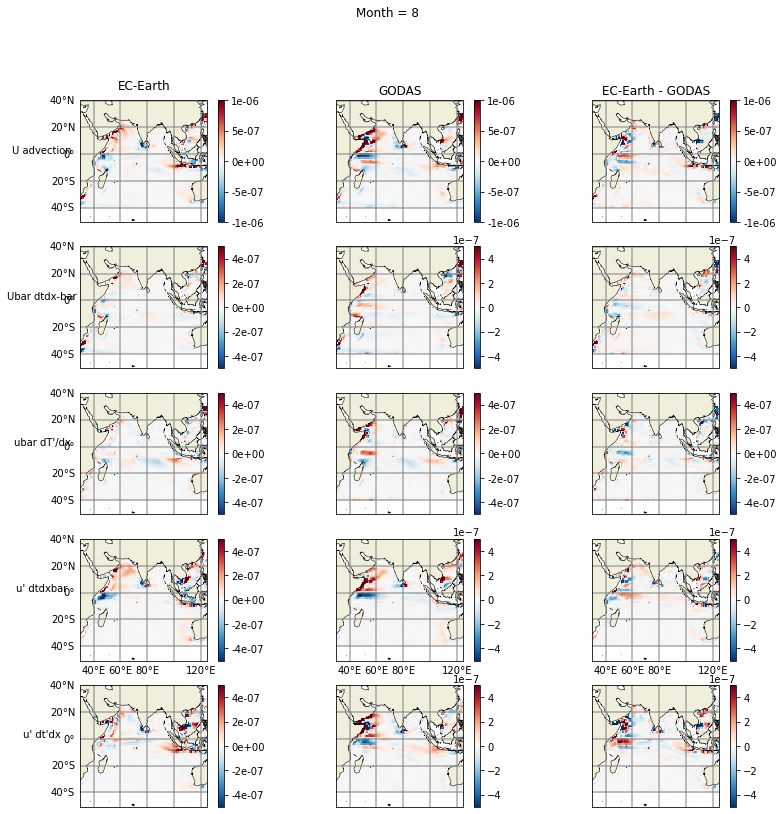

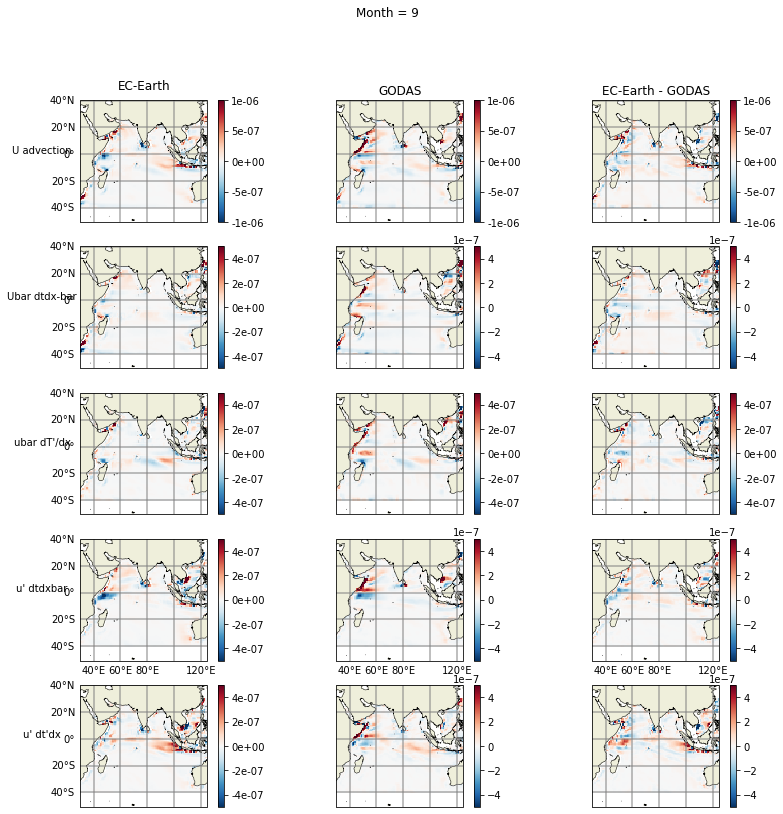

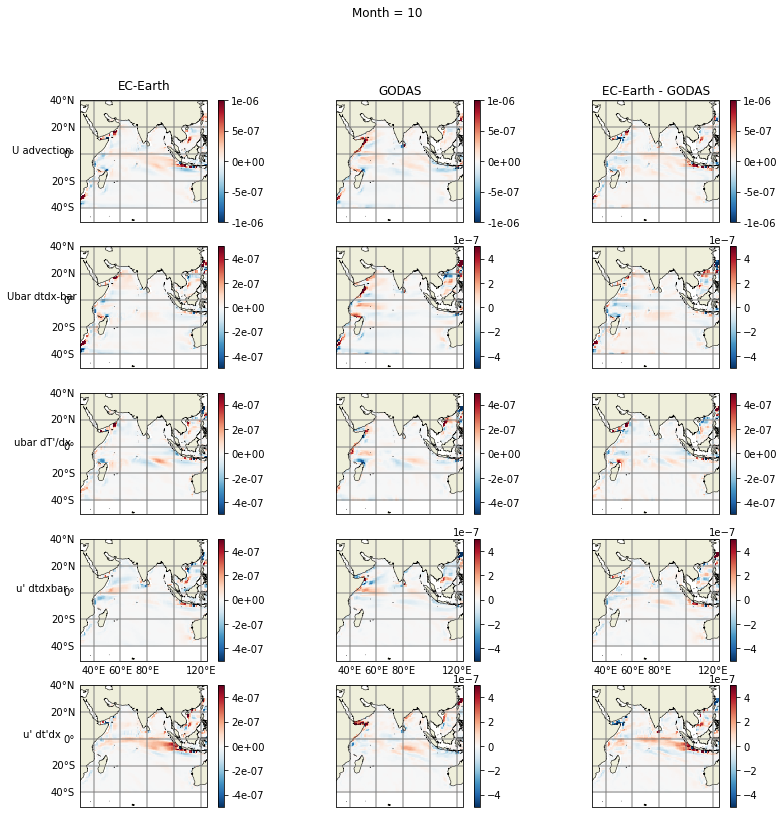

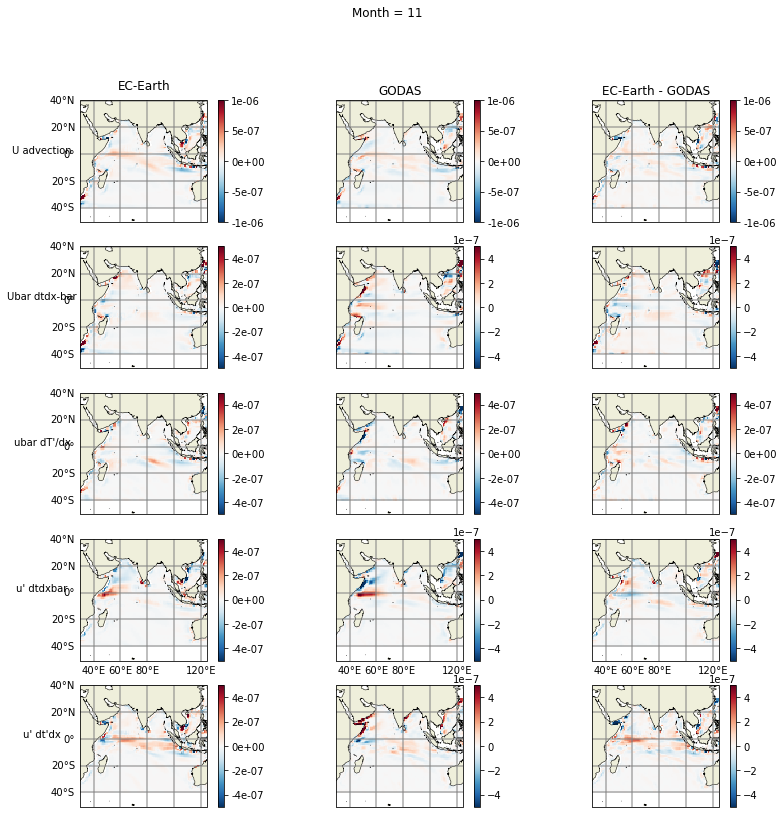

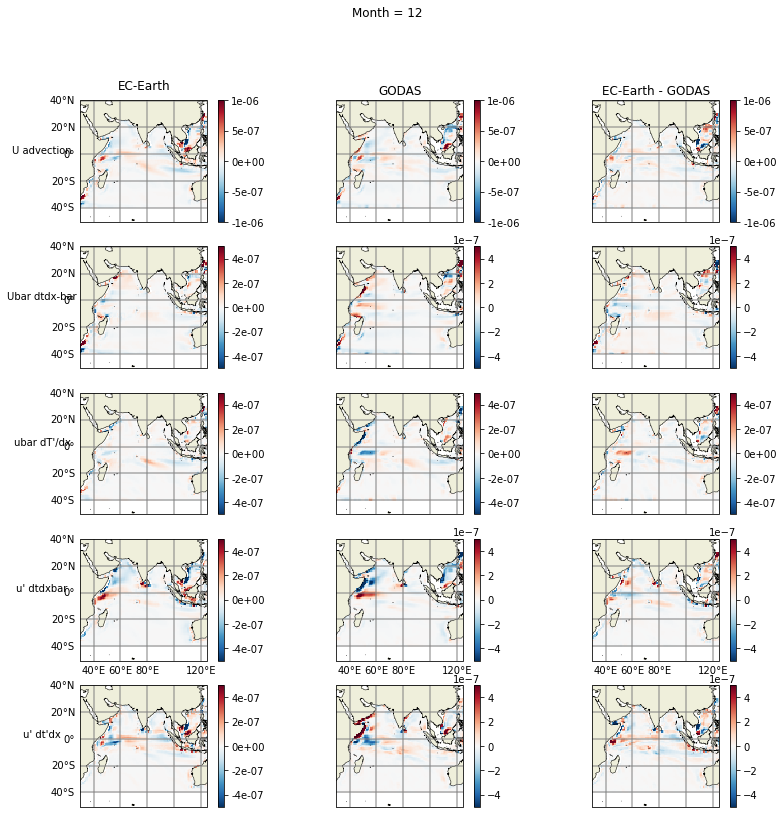

In [8]:
#u advection terms
for i in range(0,12):
    fig, axes = plt.subplots(nrows=5, ncols=3, figsize=(13, 13), sharey='all', sharex='all', 
                             subplot_kw={'projection':ccrs.PlateCarree()})
    mon = i+1
    fig.suptitle('Month = '+str(mon))
    #plot  advection term
    im = axes[0, 0].pcolormesh(lons, lats, mua.sel(month = i+1), cmap = 'RdBu_r', 
                                vmin = -1E-6, vmax = 1E-6, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[0,0], 0, 0)
    fig.colorbar(im, ax = axes[0,0],format='%.0e')
    axes[0,0].text(-0.3, 0.55, 'U advection', va='bottom', ha='center',
        rotation='horizontal', rotation_mode='anchor',
        transform=axes[0,0].transAxes)
    im = axes[0, 1].pcolormesh(lons, lats, gua.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -1e-6, vmax = 1e-6, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[0,1], 0, 1)    
    fig.colorbar(im, ax = axes[0,1],format='%.0e')
    #plot difference
    im = axes[0, 2].pcolormesh(lons, lats, dua.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -1e-6, vmax = 1e-6, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[0,2], 0, 2)    
    fig.colorbar(im, ax = axes[0,2],format='%.0e')
    axes[0,0].set_title('EC-Earth')
    axes[0,1].set_title('GODAS')
    axes[0,2].set_title('EC-Earth - GODAS')
    
    ###############################################################################################
    #plot same for advection compenents
    #ubardtdxbar
    im = axes[1, 0].pcolormesh(lons, lats, eubtb, cmap = 'RdBu_r', 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[1,0], 1, 0)
    fig.colorbar(im, ax = axes[1,0],format='%.0e')
    axes[1,0].text(-0.3, 0.55, 'Ubar dtdx-bar', va='bottom', ha='center',
        rotation='horizontal', rotation_mode='anchor',
        transform=axes[1,0].transAxes)
    im = axes[1, 1].pcolormesh(lons, lats, gubtb, cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[1,1], 1, 1)    
    fig.colorbar(im, ax = axes[1,1])
    #plot difference
    im = axes[1, 2].pcolormesh(lons, lats, (eubtb-gubtb), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[1,2], 1, 2)    
    fig.colorbar(im, ax = axes[1,2])    
    ##############################################################################################
    #same for ubardtdx'
    im = axes[2, 0].pcolormesh(lons, lats, eubtd.sel(month = i+1), cmap = 'RdBu_r', 
                                vmin = -5E-7, vmax = 5E-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[2,0], 2, 0)
    axes[2,0].text(-0.3, 0.55, "ubar dT'/dx", va='bottom', ha='center',
        rotation='horizontal', rotation_mode='anchor',
        transform=axes[2,0].transAxes)
    fig.colorbar(im, ax = axes[2,0],format='%.0e')

    im = axes[2, 1].pcolormesh(lons, lats, gubtd.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[2,1],2, 1)    
    fig.colorbar(im, ax = axes[2,1],format='%.0e')
    #plot difference
    im = axes[2, 2].pcolormesh(lons, lats, (eubtd-gubtd).sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[2,2], 2, 2)    
    fig.colorbar(im, ax = axes[2,2],format='%.0e')    
    
    #u'dtdxbar
    ##############################################################################################    
    im = axes[3, 0].pcolormesh(lons, lats, eudtb.sel(month = i+1), cmap = 'RdBu_r', 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[3,0], 3, 0)
    fig.colorbar(im, ax = axes[3,0],format='%.0e')

    axes[3,0].text(-0.3, 0.55, "u' dtdxbar", va='bottom', ha='center',
        rotation='horizontal', rotation_mode='anchor',
        transform=axes[3,0].transAxes)
    im = axes[3, 1].pcolormesh(lons, lats, gudtb.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[3,1], 3, 1)    
    fig.colorbar(im, ax = axes[3,1], )
    #plot difference
    im = axes[3, 2].pcolormesh(lons, lats, (eudtb-gudtb).sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[3,2], 3, 2)    
    fig.colorbar(im, ax = axes[3,2])
        #u'dtdx'bar'
    ##############################################################################################    
    im = axes[4, 0].pcolormesh(lons, lats, eudtd.sel(month = i+1), cmap = 'RdBu_r', 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[4,0], 4, 0)
    fig.colorbar(im, ax = axes[4,0],format='%.0e')

    axes[4,0].text(-0.3, 0.55, "u' dt'dx", va='bottom', ha='center',
        rotation='horizontal', rotation_mode='anchor',
        transform=axes[4,0].transAxes)
    im = axes[4, 1].pcolormesh(lons, lats, gudtd.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[4,1], 4, 1)    
    fig.colorbar(im, ax = axes[4,1], )
    #plot difference
    im = axes[4, 2].pcolormesh(lons, lats, (eudtd-gudtd).sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[4,2], 4, 2)    
    fig.colorbar(im, ax = axes[4,2])
    fig.savefig('/home/z5113258/Documents/figures/model_obs/seasonal_cycle/adv/U_terms_'+str(mon)+'.png', dpi = 300, bbox_inches='tight')

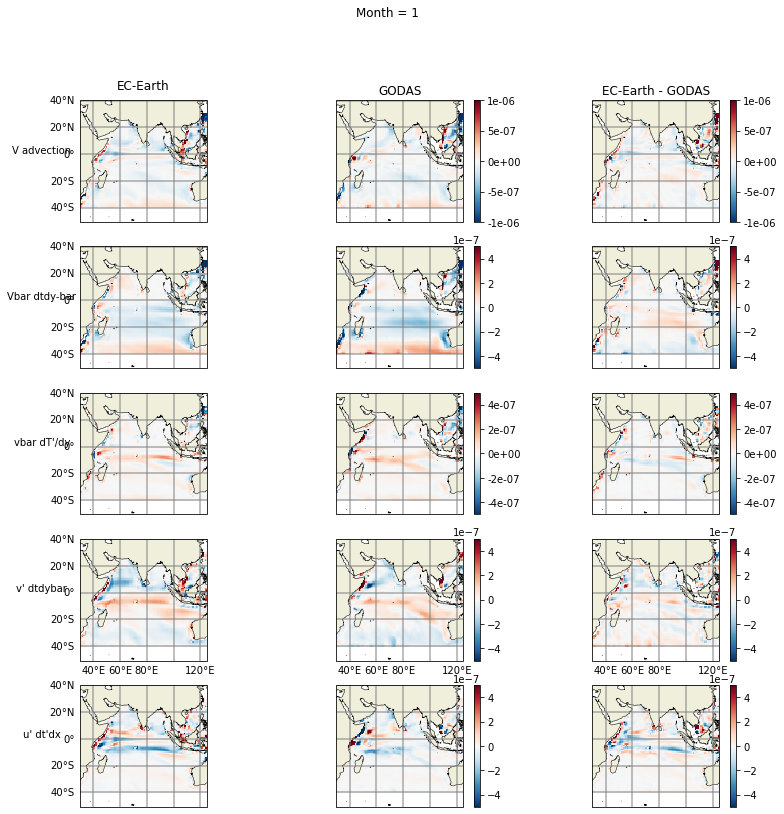

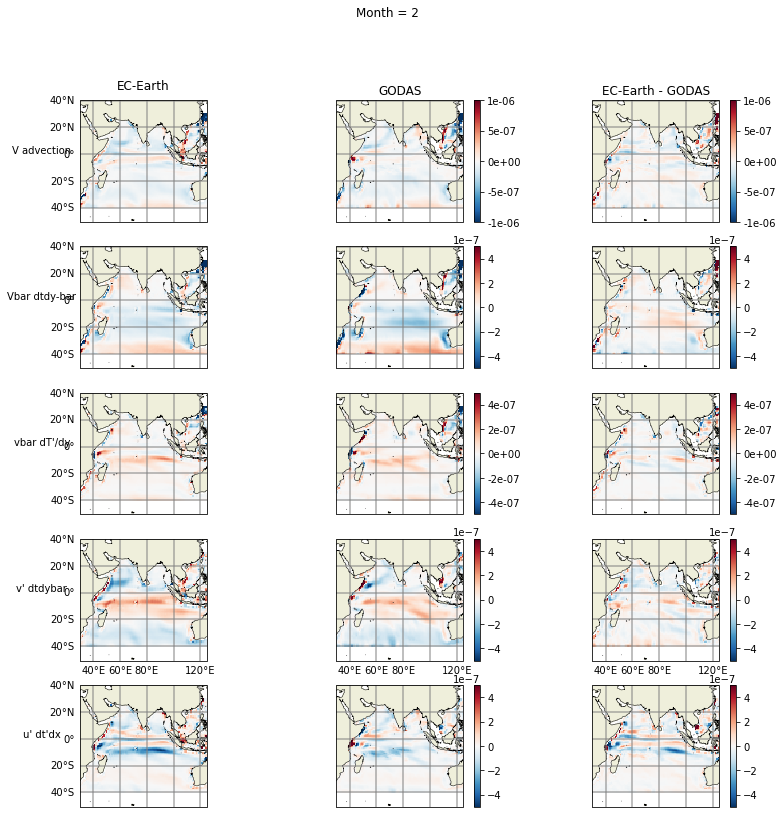

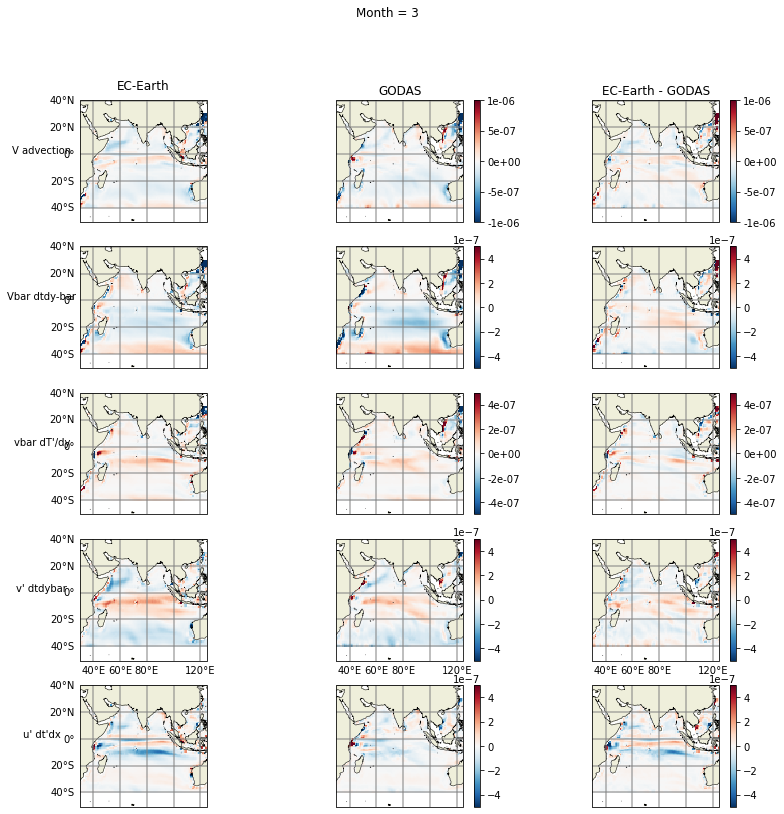

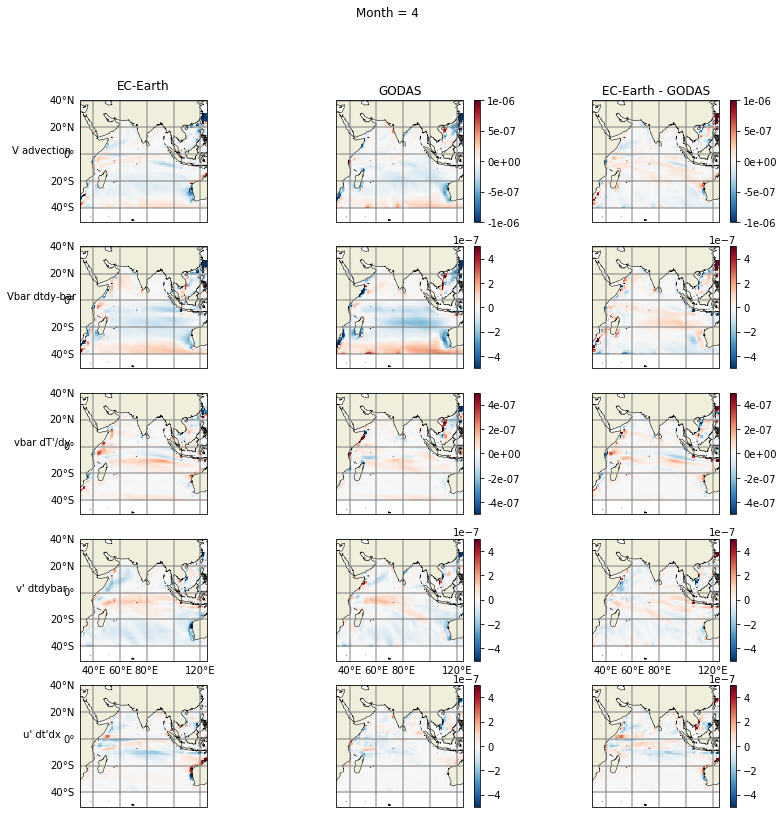

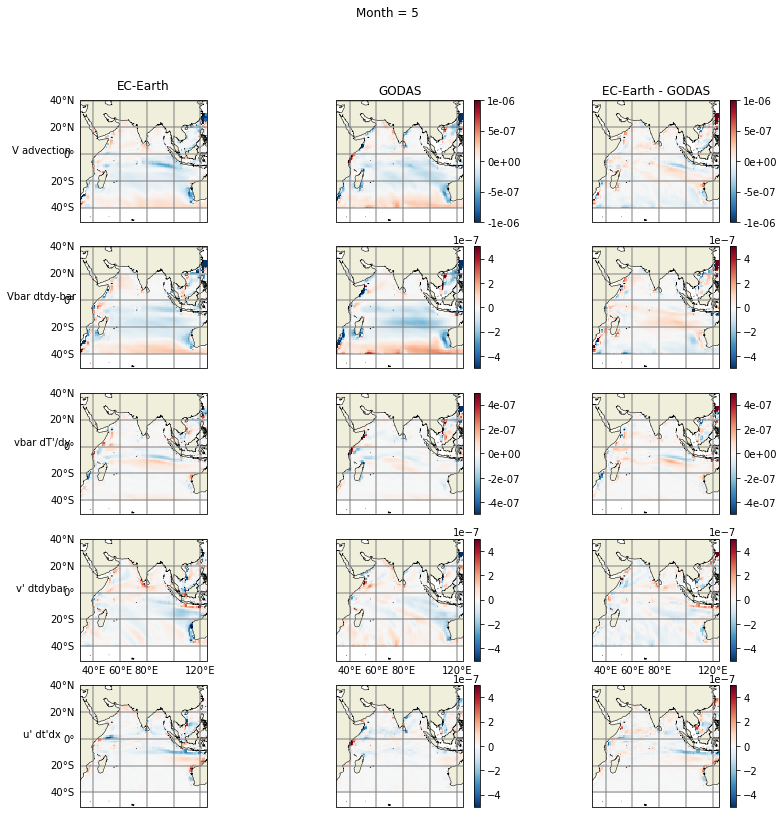

...

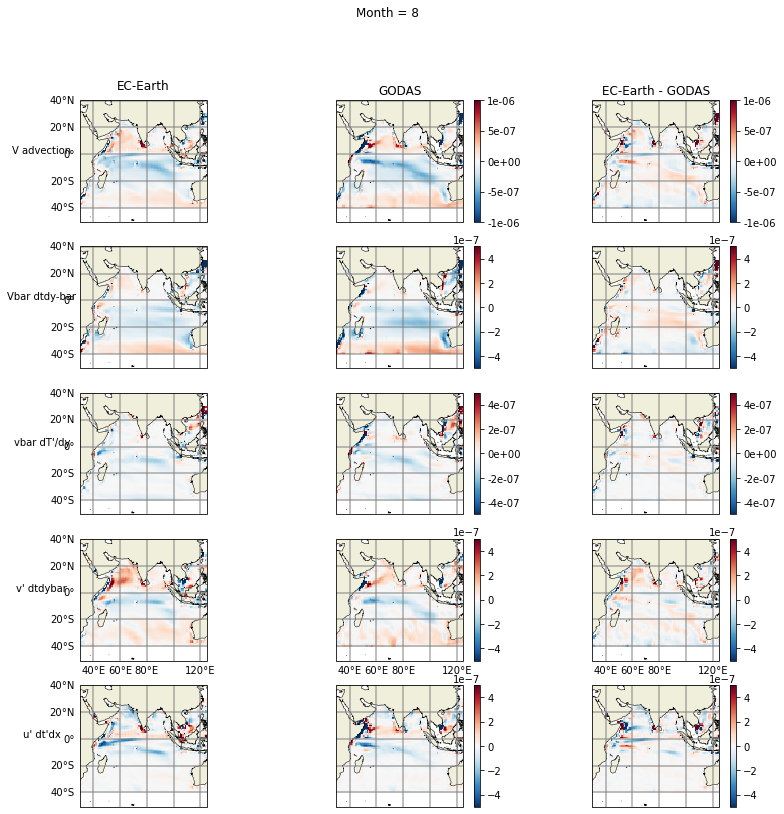

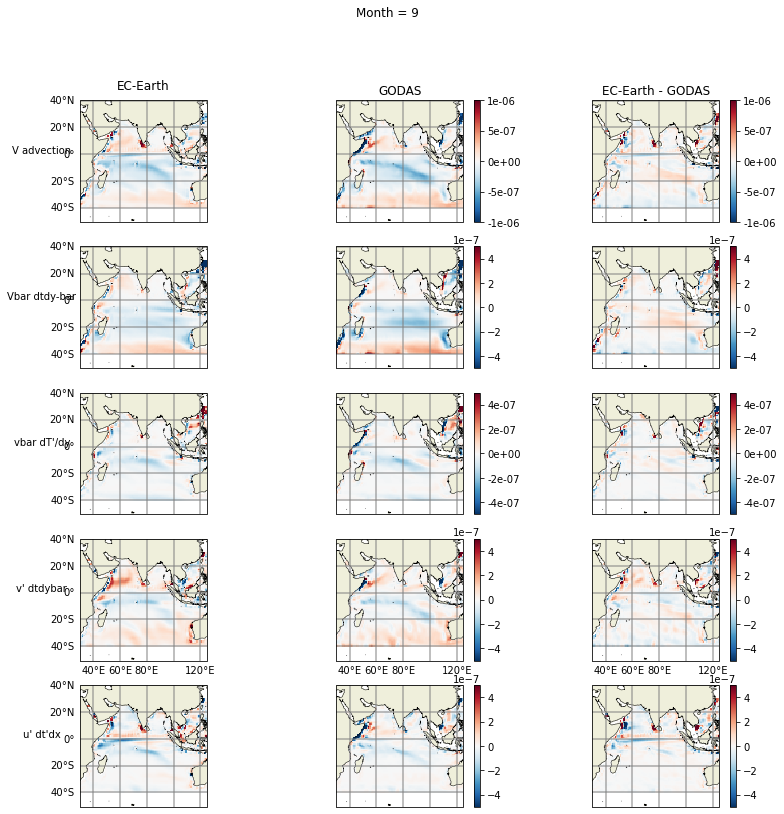

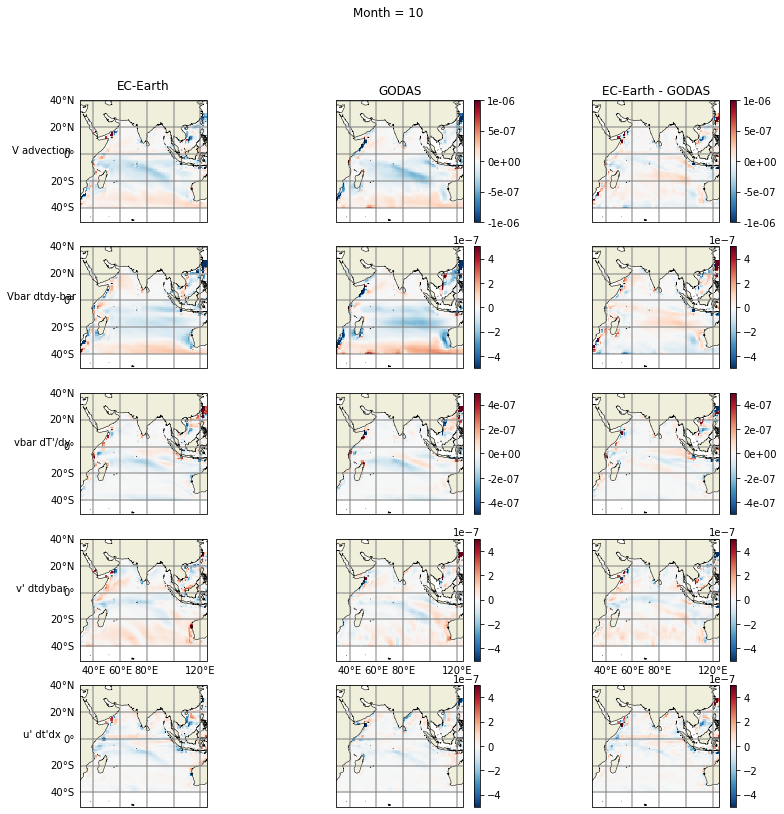

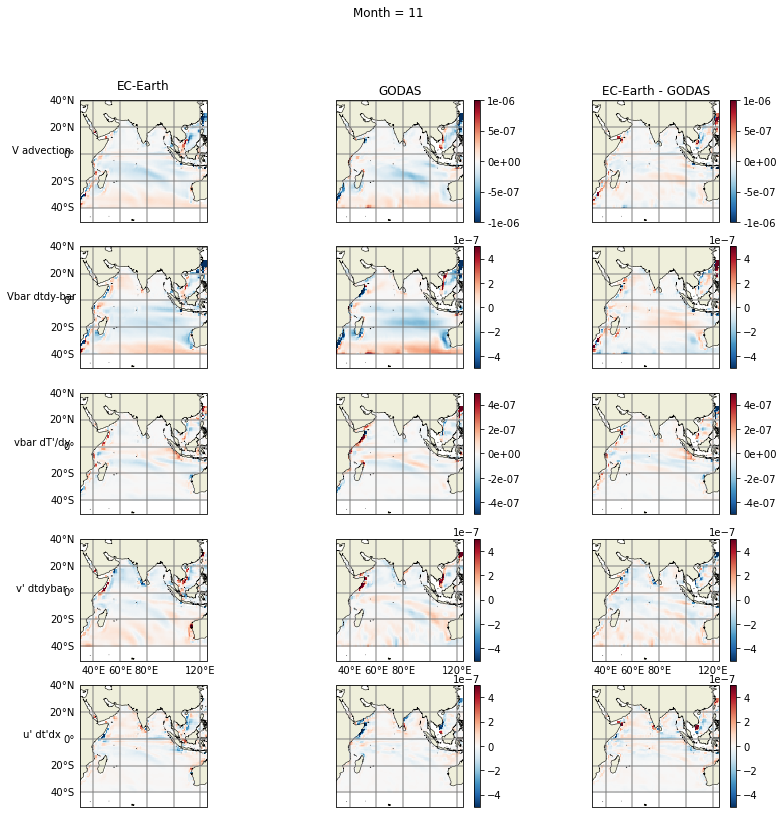

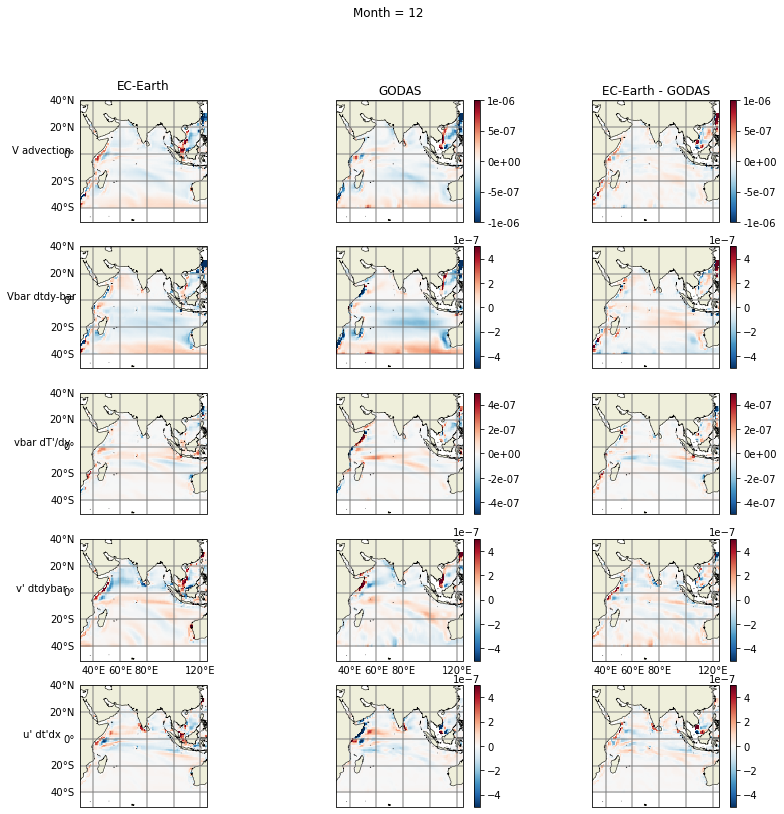

In [9]:
for i in range(0,12):
    fig, axes = plt.subplots(nrows=5, ncols=3, figsize=(13, 13), sharey='all', sharex='all', 
                             subplot_kw={'projection':ccrs.PlateCarree()})
    mon = i+1
    fig.suptitle('Month = '+str(mon))
    #plot  advection term
    axes[0, 0].pcolormesh(lons, lats, mva.sel(month = i+1), cmap = 'RdBu_r', 
                                vmin = -1E-6, vmax = 1E-6, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[0,0], 0, 0)
    axes[0,0].text(-0.3, 0.55, 'V advection', va='bottom', ha='center',
        rotation='horizontal', rotation_mode='anchor',
        transform=axes[0,0].transAxes)
    im = axes[0, 1].pcolormesh(lons, lats, gva.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -1e-6, vmax = 1e-6, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[0,1], 0, 1)    
    fig.colorbar(im, ax = axes[0,1],format='%.0e')
    #plot difference
    im = axes[0, 2].pcolormesh(lons, lats, dva.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -1e-6, vmax = 1e-6, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[0,2], 0, 2)    
    fig.colorbar(im, ax = axes[0,2],format='%.0e')
    axes[0,0].set_title('EC-Earth')
    axes[0,1].set_title('GODAS')
    axes[0,2].set_title('EC-Earth - GODAS')
    
    ###############################################################################################
    #plot same for advection compenents
    #ubardtdxbar
    axes[1, 0].pcolormesh(lons, lats, evbtb, cmap = 'RdBu_r', 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[1,0], 1, 0)
    axes[1,0].text(-0.3, 0.55, 'Vbar dtdy-bar', va='bottom', ha='center',
        rotation='horizontal', rotation_mode='anchor',
        transform=axes[1,0].transAxes)
    im = axes[1, 1].pcolormesh(lons, lats, gvbtb, cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[1,1], 1, 1)    
    fig.colorbar(im, ax = axes[1,1])
    #plot difference
    im = axes[1, 2].pcolormesh(lons, lats, (evbtb-gvbtb), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[1,2], 1, 2)    
    fig.colorbar(im, ax = axes[1,2])    
    ##############################################################################################
    #same for ubardtdx'
    axes[2, 0].pcolormesh(lons, lats, evbtd.sel(month = i+1), cmap = 'RdBu_r', 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[2,0], 2, 0)
    axes[2,0].text(-0.3, 0.55, "vbar dT'/dy", va='bottom', ha='center',
        rotation='horizontal', rotation_mode='anchor',
        transform=axes[2,0].transAxes)
    im = axes[2, 1].pcolormesh(lons, lats, gvbtd.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[2,1],2, 1)    
    fig.colorbar(im, ax = axes[2,1],format='%.0e')
    #plot difference
    im = axes[2, 2].pcolormesh(lons, lats, (evbtd-gvbtd).sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[2,2], 2, 2)    
    fig.colorbar(im, ax = axes[2,2],format='%.0e')    
    
    #u'dtdxbar
    ##############################################################################################    
    axes[3, 0].pcolormesh(lons, lats, evdtb.sel(month = i+1), cmap = 'RdBu_r', 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[3,0], 3, 0)
    axes[3,0].text(-0.3, 0.55, "v' dtdybar", va='bottom', ha='center',
        rotation='horizontal', rotation_mode='anchor',
        transform=axes[3,0].transAxes)
    im = axes[3, 1].pcolormesh(lons, lats, gvdtb.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[3,1], 3, 1)    
    fig.colorbar(im, ax = axes[3,1], )
    #plot difference
    im = axes[3, 2].pcolormesh(lons, lats, (evdtb-gvdtb).sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[3,2], 3, 2)    
    fig.colorbar(im, ax = axes[3,2])
        #u'dtdx'bar'
    ##############################################################################################    
    axes[4, 0].pcolormesh(lons, lats, evdtd.sel(month = i+1), cmap = 'RdBu_r', 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[4,0], 4, 0)
    axes[4,0].text(-0.3, 0.55, "u' dt'dx", va='bottom', ha='center',
        rotation='horizontal', rotation_mode='anchor',
        transform=axes[4,0].transAxes)
    im = axes[4, 1].pcolormesh(lons, lats, gvdtd.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[4,1], 4, 1)    
    fig.colorbar(im, ax = axes[4,1], )
    #plot difference
    im = axes[4, 2].pcolormesh(lons, lats, (evdtd-gvdtd).sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[4,2], 4, 2)    
    fig.colorbar(im, ax = axes[4,2])
    fig.savefig('/home/z5113258/Documents/figures/model_obs/seasonal_cycle/adv/V_terms_'+str(mon)+'.png', dpi = 300, bbox_inches='tight') 

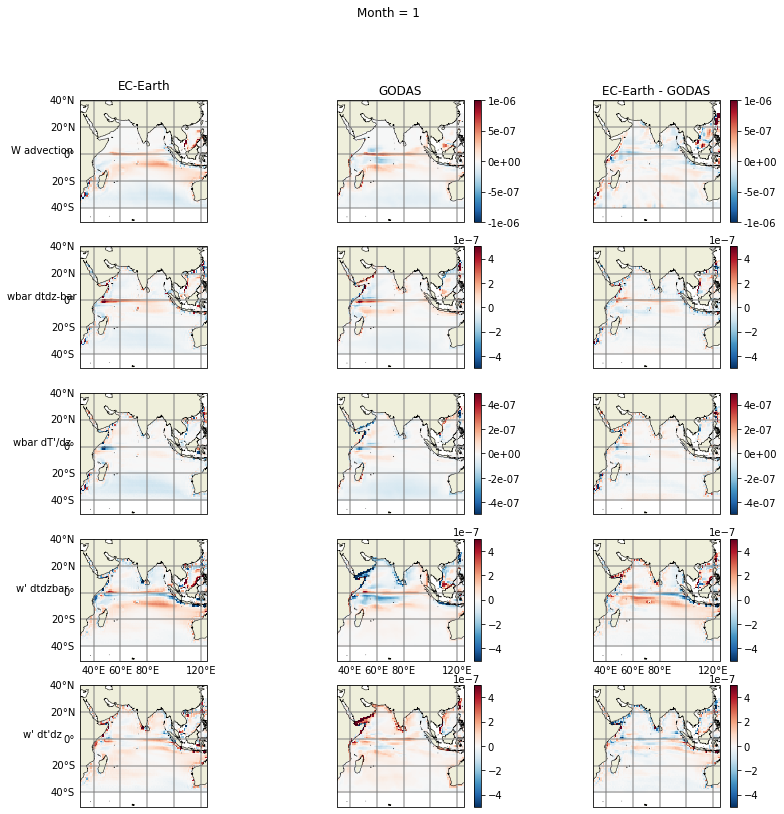

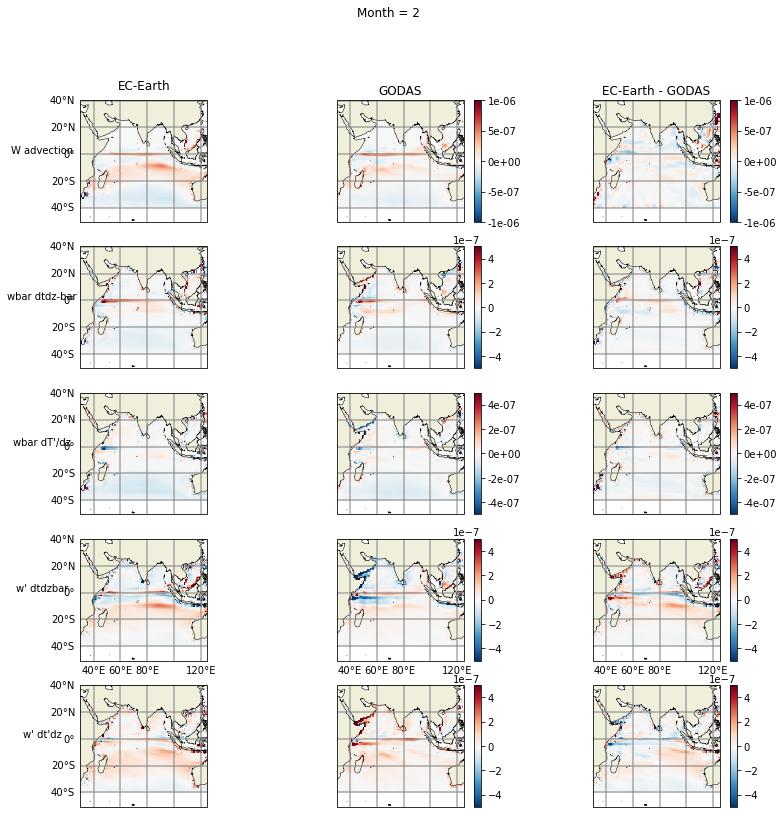

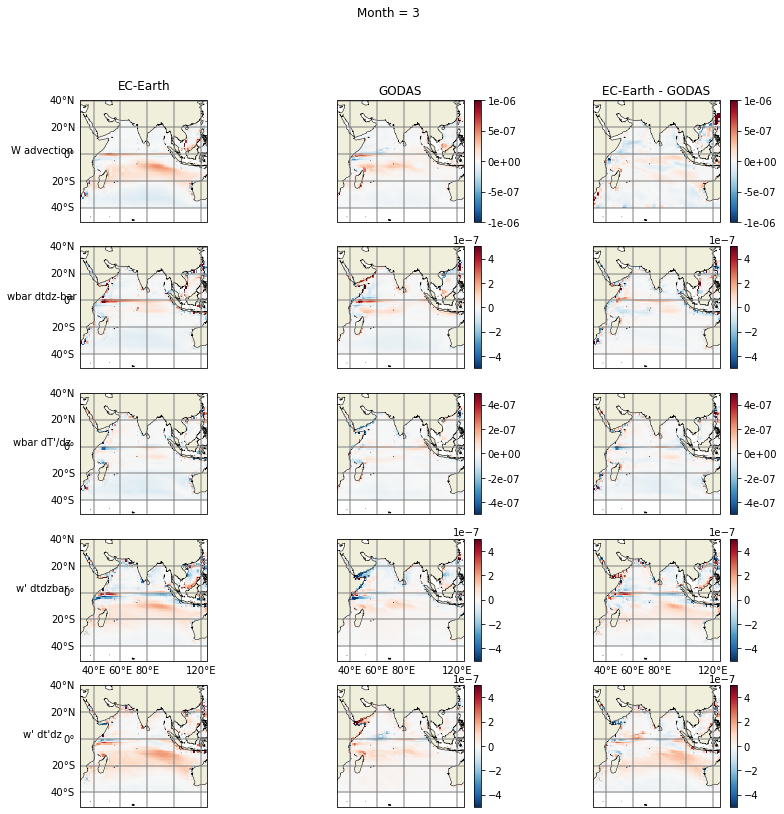

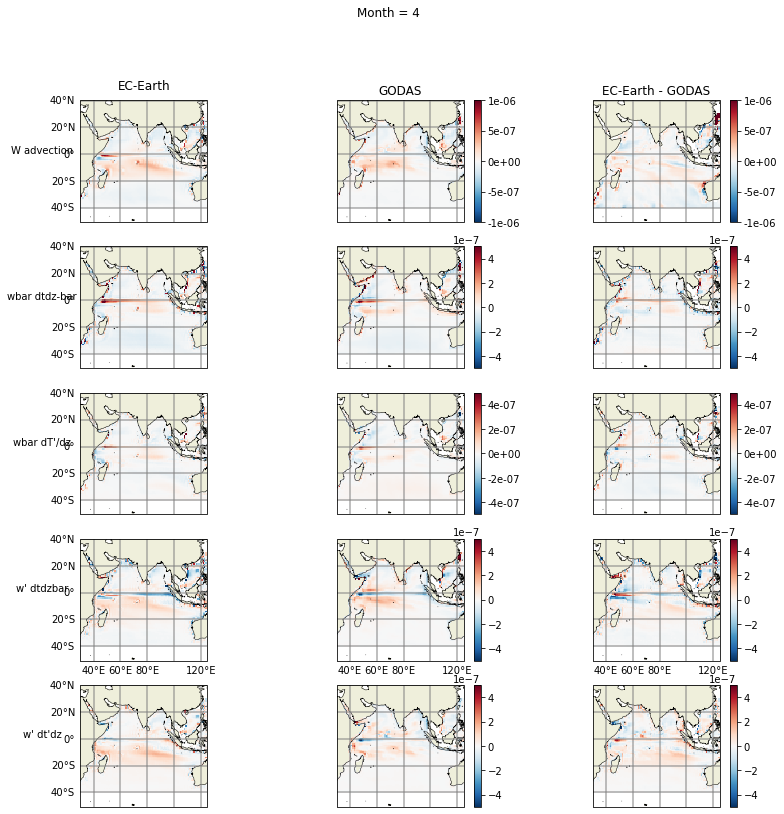

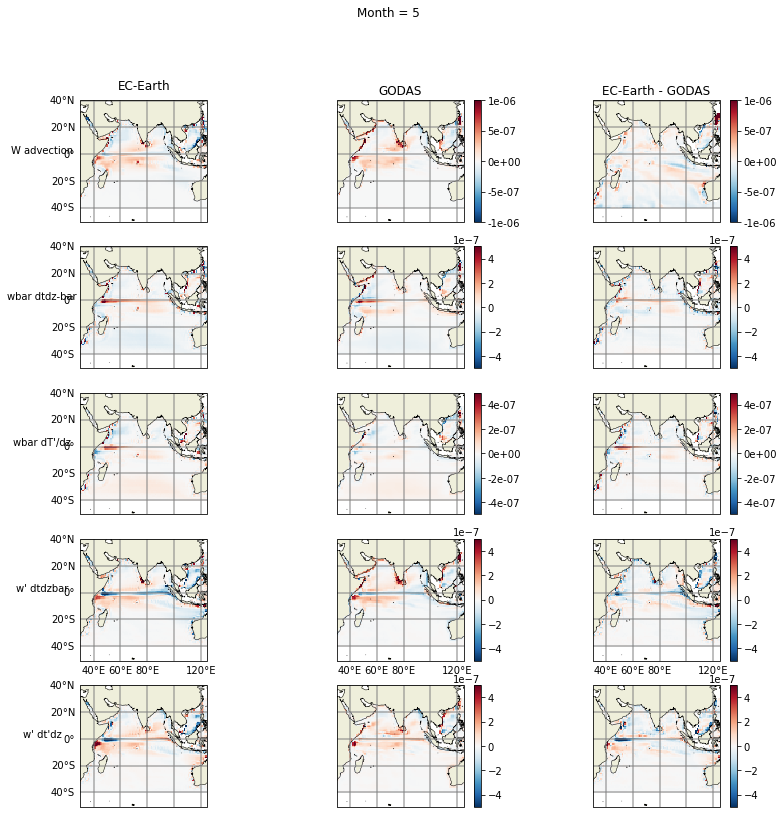

...

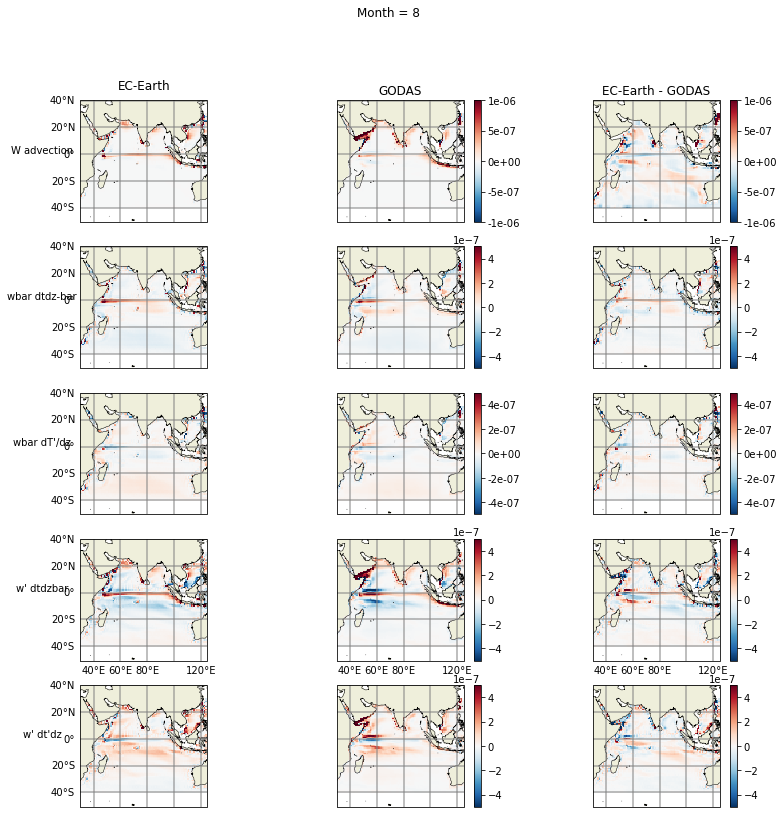

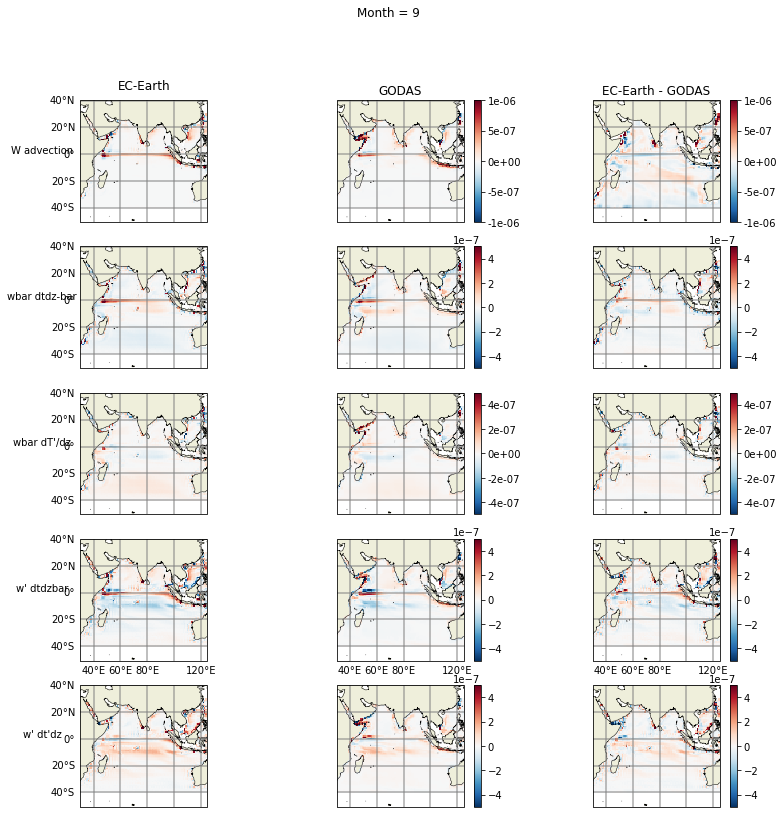

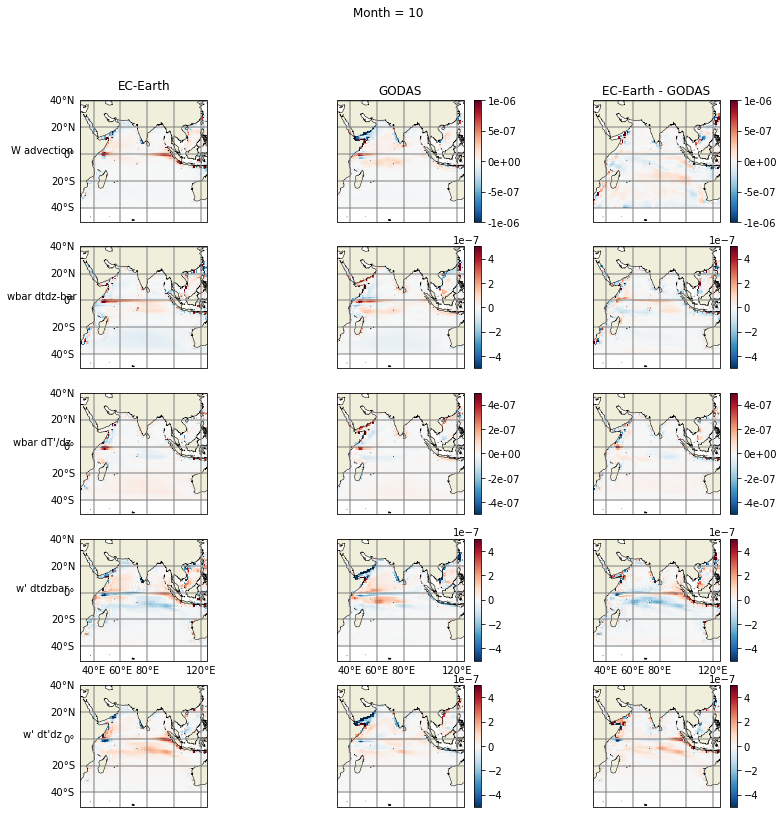

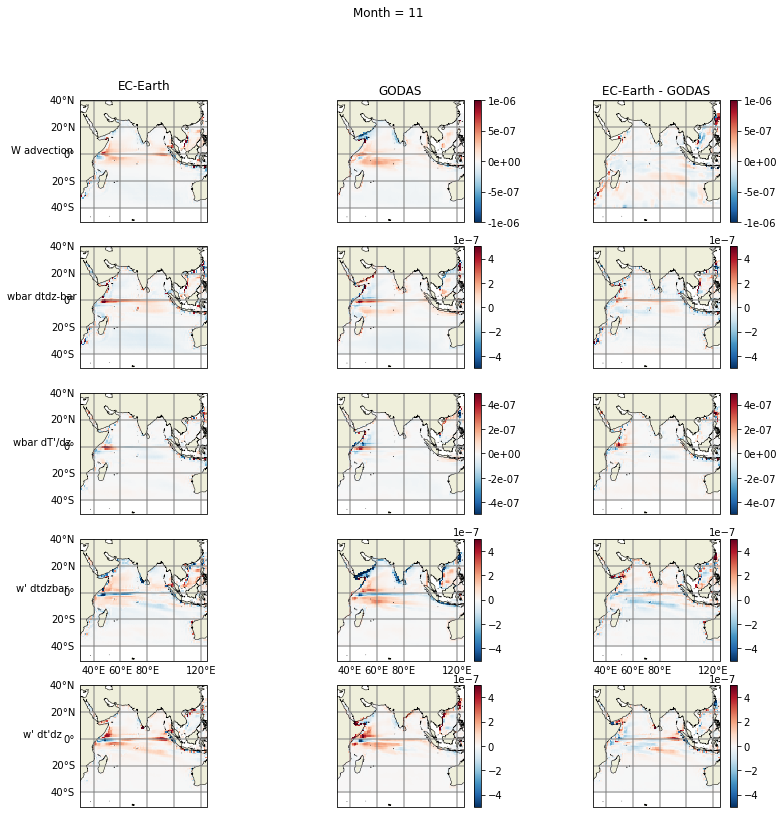

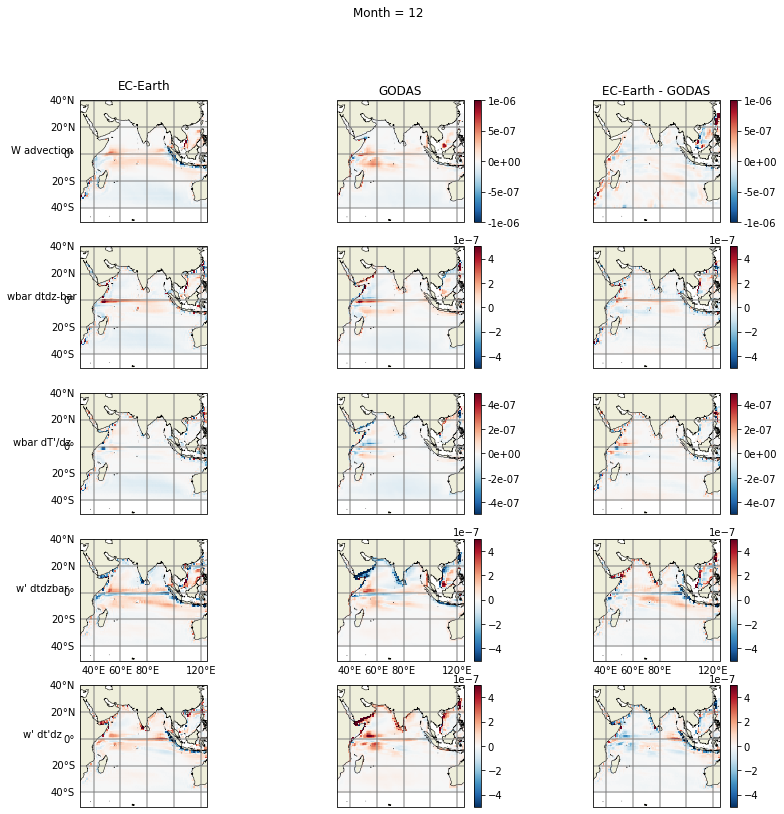

In [10]:
for i in range(0,12):
    fig, axes = plt.subplots(nrows=5, ncols=3, figsize=(13, 13), sharey='all', sharex='all', 
                             subplot_kw={'projection':ccrs.PlateCarree()})
    mon = i+1
    fig.suptitle('Month = '+str(mon))
    #plot  advection term
    axes[0, 0].pcolormesh(lons, lats, mwa.sel(month = i+1), cmap = 'RdBu_r', 
                                vmin = -1E-6, vmax = 1E-6, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[0,0], 0, 0)
    axes[0,0].text(-0.3, 0.55, 'W advection', va='bottom', ha='center',
        rotation='horizontal', rotation_mode='anchor',
        transform=axes[0,0].transAxes)
    im = axes[0, 1].pcolormesh(lons, lats, gwa.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -1e-6, vmax = 1e-6, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[0,1], 0, 1)    
    fig.colorbar(im, ax = axes[0,1],format='%.0e')
    #plot difference
    im = axes[0, 2].pcolormesh(lons, lats, dva.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -1e-6, vmax = 1e-6, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[0,2], 0, 2)    
    fig.colorbar(im, ax = axes[0,2],format='%.0e')
    axes[0,0].set_title('EC-Earth')
    axes[0,1].set_title('GODAS')
    axes[0,2].set_title('EC-Earth - GODAS')
    
    ###############################################################################################
    #plot same for advection compenents
    #ubardtdxbar
    axes[1, 0].pcolormesh(lons, lats, ewbtb, cmap = 'RdBu_r', 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[1,0], 1, 0)
    axes[1,0].text(-0.3, 0.55, 'wbar dtdz-bar', va='bottom', ha='center',
        rotation='horizontal', rotation_mode='anchor',
        transform=axes[1,0].transAxes)
    im = axes[1, 1].pcolormesh(lons, lats, gwbtb, cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[1,1], 1, 1)    
    fig.colorbar(im, ax = axes[1,1])
    #plot difference
    im = axes[1, 2].pcolormesh(lons, lats, (ewbtb-gwbtb), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[1,2], 1, 2)    
    fig.colorbar(im, ax = axes[1,2])    
    ##############################################################################################
    #same for ubardtdx'
    axes[2, 0].pcolormesh(lons, lats, ewbtd.sel(month = i+1), cmap = 'RdBu_r', 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[2,0], 2, 0)
    axes[2,0].text(-0.3, 0.55, "wbar dT'/dz", va='bottom', ha='center',
        rotation='horizontal', rotation_mode='anchor',
        transform=axes[2,0].transAxes)
    im = axes[2, 1].pcolormesh(lons, lats, gwbtd.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[2,1],2, 1)    
    fig.colorbar(im, ax = axes[2,1],format='%.0e')
    #plot difference
    im = axes[2, 2].pcolormesh(lons, lats, (ewbtd-gwbtd).sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[2,2], 2, 2)    
    fig.colorbar(im, ax = axes[2,2],format='%.0e')    
    
    #u'dtdxbar
    ##############################################################################################    
    axes[3, 0].pcolormesh(lons, lats, ewdtb.sel(month = i+1), cmap = 'RdBu_r', 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[3,0], 3, 0)
    axes[3,0].text(-0.3, 0.55, "w' dtdzbar", va='bottom', ha='center',
        rotation='horizontal', rotation_mode='anchor',
        transform=axes[3,0].transAxes)
    im = axes[3, 1].pcolormesh(lons, lats, gwdtb.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[3,1], 3, 1)    
    fig.colorbar(im, ax = axes[3,1], )
    #plot difference
    im = axes[3, 2].pcolormesh(lons, lats, (ewdtb-gwdtb).sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[3,2], 3, 2)    
    fig.colorbar(im, ax = axes[3,2])
        #u'dtdx'bar'
    ##############################################################################################    
    axes[4, 0].pcolormesh(lons, lats, ewdtd.sel(month = i+1), cmap = 'RdBu_r', 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[4,0], 4, 0)
    axes[4,0].text(-0.3, 0.55, "w' dt'dz", va='bottom', ha='center',
        rotation='horizontal', rotation_mode='anchor',
        transform=axes[4,0].transAxes)
    im = axes[4, 1].pcolormesh(lons, lats, gwdtd.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[4,1], 4, 1)    
    fig.colorbar(im, ax = axes[4,1], )
    #plot difference
    im = axes[4, 2].pcolormesh(lons, lats, (ewdtd-gwdtd).sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -5e-7, vmax = 5e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[4,2], 4, 2)    
    fig.colorbar(im, ax = axes[4,2])
    fig.savefig('/home/z5113258/Documents/figures/model_obs/seasonal_cycle/adv/W_terms_'+str(mon)+'.png', dpi = 300, bbox_inches='tight') 

Text(0.5, 1.0, 'GODAS  \n U advection - $\\bar{u} \\frac{d\\bar{T}}{dx}$')

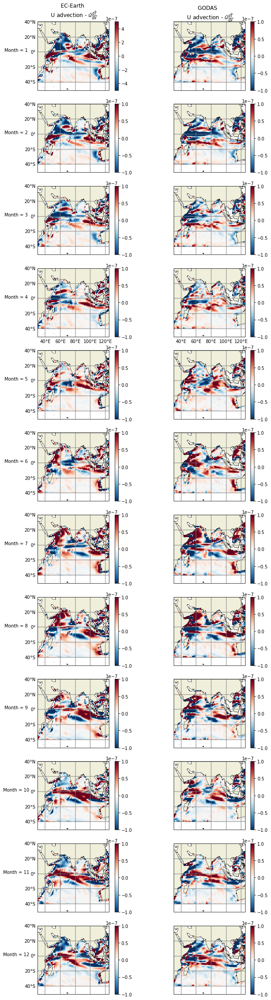

In [11]:
fig, axes = plt.subplots(nrows=12, ncols=2, figsize=(10, 40), sharey='all', sharex='all', 
                             subplot_kw={'projection':ccrs.PlateCarree()})
for i in range(0,12):
    
    axes[i, 0].pcolormesh(lons, lats, (mua-eubtb).sel(month = i+1), cmap = 'RdBu_r', 
                                vmin = -1e-7, vmax = 1e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[i,0], i, 0)
    fig.colorbar(im, ax = axes[i,0])
    mon = i+1
    axes[i,0].text(-0.3, 0.55, 'Month = '+str(mon), va='bottom', ha='center',
        rotation='horizontal', rotation_mode='anchor',
        transform=axes[i,0].transAxes)
    im = axes[i, 1].pcolormesh(lons, lats, (gua-gubtb).sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -1e-7, vmax = 1e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[i,1], i, 1)    
    fig.colorbar(im, ax = axes[i,1])
axes[0,0].set_title('EC-Earth \n U advection - 'r'$\bar{u} \frac{d\bar{T}}{dx}$')
axes[0,1].set_title('GODAS  \n U advection - 'r'$\bar{u} \frac{d\bar{T}}{dx}$')
#fig.savefig('/home/z5113258/Documents/figures/model_obs/seasonal_cycle/uadv_clim_diff.png', dpi = 300, bbox_inches='tight')
    

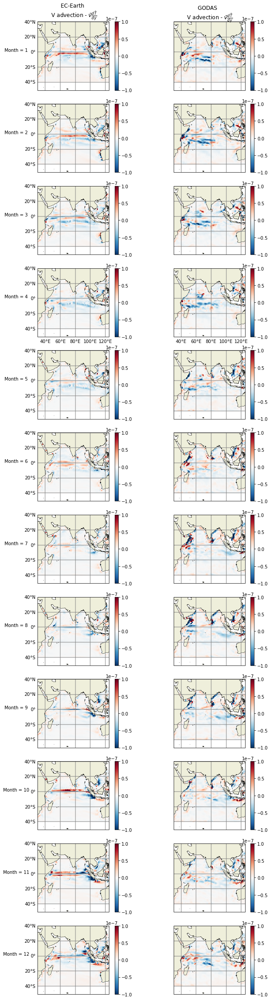

In [92]:
fig, axes = plt.subplots(nrows=12, ncols=2, figsize=(10, 40), sharey='all', sharex='all', 
                             subplot_kw={'projection':ccrs.PlateCarree()})
for i in range(0,12):
    
    axes[i, 0].pcolormesh(lons, lats, (mva-evbtb).sel(month = i+1), cmap = 'RdBu_r', 
                                vmin = -1e-7, vmax = 1e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[i,0], i, 0)
    fig.colorbar(im, ax = axes[i,0])
    mon = i+1
    axes[i,0].text(-0.3, 0.55, 'Month = '+str(mon), va='bottom', ha='center',
        rotation='horizontal', rotation_mode='anchor',
        transform=axes[i,0].transAxes)
    im = axes[i, 1].pcolormesh(lons, lats, (gva-gvbtb).sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -1e-7, vmax = 1e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[i,1], i, 1)    
    fig.colorbar(im, ax = axes[i,1])
axes[0,0].set_title('EC-Earth \n V advection - 'r'$\bar{v} \frac{d\bar{T}}{dy}$')
axes[0,1].set_title('GODAS  \n V advection - 'r'$\bar{v} \frac{d\bar{T}}{dy}$')
fig.savefig('/home/z5113258/Documents/figures/vadv_clim_diff.png', dpi = 300, bbox_inches='tight')

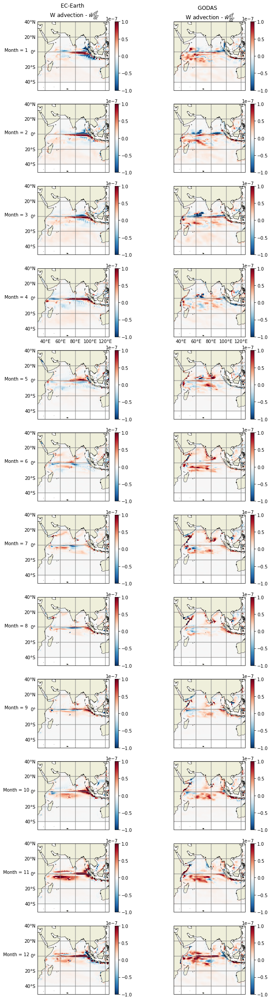

In [93]:
fig, axes = plt.subplots(nrows=12, ncols=2, figsize=(10, 40), sharey='all', sharex='all', 
                             subplot_kw={'projection':ccrs.PlateCarree()})
for i in range(0,12):
    
    axes[i, 0].pcolormesh(lons, lats, (mwa-ewbtb).sel(month = i+1), cmap = 'RdBu_r', 
                                vmin = -1e-7, vmax = 1e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[i,0], i, 0)
    fig.colorbar(im, ax = axes[i,0])
    mon = i+1
    axes[i,0].text(-0.3, 0.55, 'Month = '+str(mon), va='bottom', ha='center',
        rotation='horizontal', rotation_mode='anchor',
        transform=axes[i,0].transAxes)
    im = axes[i, 1].pcolormesh(lons, lats, (gwa-gwbtb).sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -1e-7, vmax = 1e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[i,1], i, 1)    
    fig.colorbar(im, ax = axes[i,1])
axes[0,0].set_title('EC-Earth \n W advection - 'r'$\bar{w} \frac{d\bar{T}}{dz}$')
axes[0,1].set_title('GODAS  \n W advection - 'r'$\bar{w} \frac{d\bar{T}}{dz}$')
fig.savefig('/home/z5113258/Documents/figures/wadv_clim_diff.png', dpi = 300, bbox_inches='tight')

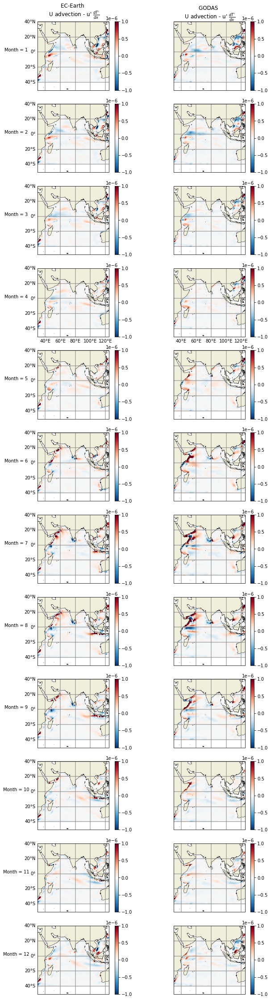

In [100]:
#differnce to eddy compeontn
fig, axes = plt.subplots(nrows=12, ncols=2, figsize=(10, 40), sharey='all', sharex='all', 
                             subplot_kw={'projection':ccrs.PlateCarree()})
for i in range(0,12):
    
    axes[i, 0].pcolormesh(lons, lats, (mua-eudtd).sel(month = i+1), cmap = 'RdBu_r', 
                                vmin = -1e-6, vmax = 1e-6, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[i,0], i, 0)
    fig.colorbar(im, ax = axes[i,0])
    mon = i+1
    axes[i,0].text(-0.3, 0.55, 'Month = '+str(mon), va='bottom', ha='center',
        rotation='horizontal', rotation_mode='anchor',
        transform=axes[i,0].transAxes)
    im = axes[i, 1].pcolormesh(lons, lats, (gua-gudtd).sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -1e-6, vmax = 1e-6, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[i,1], i, 1)    
    fig.colorbar(im, ax = axes[i,1])
axes[0,0].set_title("EC-Earth \n U advection - u' "r"$\frac{dT'}{dx}$")
axes[0,1].set_title("GODAS \n U advection - u' "r"$\frac{dT'}{dx}$")
fig.savefig('/home/z5113258/Documents/figures/uadv_eddy_diff.png', dpi = 300, bbox_inches='tight')


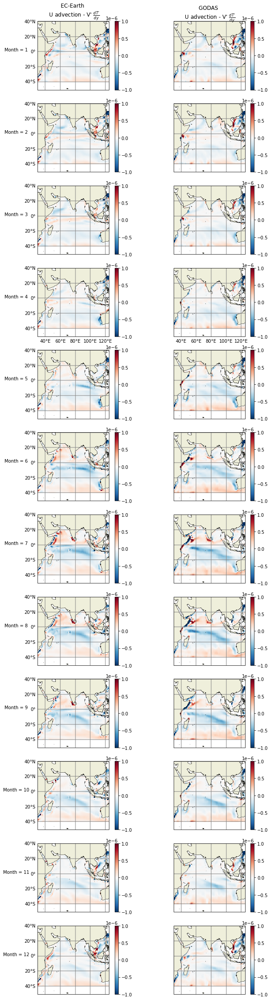

In [105]:
#differnce to eddy compeontn
fig, axes = plt.subplots(nrows=12, ncols=2, figsize=(10, 40), sharey='all', sharex='all', 
                             subplot_kw={'projection':ccrs.PlateCarree()})
for i in range(0,12):
    
    axes[i, 0].pcolormesh(lons, lats, (mva-evdtd).sel(month = i+1), cmap = 'RdBu_r', 
                                vmin = -1e-6, vmax = 1e-6, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[i,0], i, 0)
    fig.colorbar(im, ax = axes[i,0])
    mon = i+1
    axes[i,0].text(-0.3, 0.55, 'Month = '+str(mon), va='bottom', ha='center',
        rotation='horizontal', rotation_mode='anchor',
        transform=axes[i,0].transAxes)
    im = axes[i, 1].pcolormesh(lons, lats, (gva-gvdtd).sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -1e-6, vmax = 1e-6, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[i,1], i, 1)    
    fig.colorbar(im, ax = axes[i,1])
axes[0,0].set_title("EC-Earth \n U advection - V' "r"$\frac{dT'}{dy}$")
axes[0,1].set_title("GODAS \n U advection - V' "r"$\frac{dT'}{dy}$")
fig.savefig('/home/z5113258/Documents/figures/model_obs/Vadv_eddy_diff.png', dpi = 300, bbox_inches='tight')

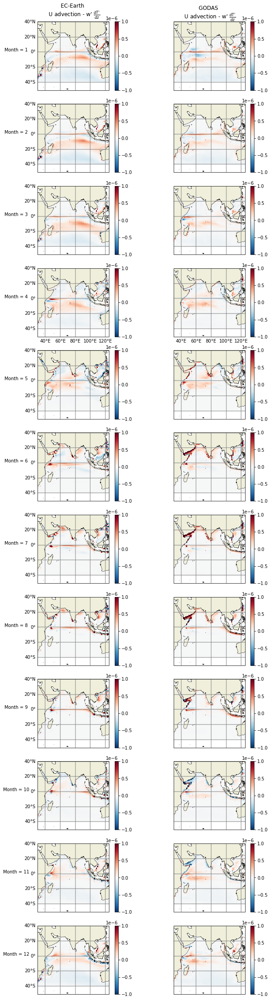

In [106]:
#differnce to eddy compeontn
fig, axes = plt.subplots(nrows=12, ncols=2, figsize=(10, 40), sharey='all', sharex='all', 
                             subplot_kw={'projection':ccrs.PlateCarree()})
for i in range(0,12):
    
    axes[i, 0].pcolormesh(lons, lats, (mwa-ewdtd).sel(month = i+1), cmap = 'RdBu_r', 
                                vmin = -1e-6, vmax = 1e-6, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[i,0], i, 0)
    fig.colorbar(im, ax = axes[i,0])
    mon = i+1
    axes[i,0].text(-0.3, 0.55, 'Month = '+str(mon), va='bottom', ha='center',
        rotation='horizontal', rotation_mode='anchor',
        transform=axes[i,0].transAxes)
    im = axes[i, 1].pcolormesh(lons, lats, (gwa-gwdtd).sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -1e-6, vmax = 1e-6, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[i,1], i, 1)    
    fig.colorbar(im, ax = axes[i,1])
axes[0,0].set_title("EC-Earth \n U advection - w' "r"$\frac{dT'}{dz}$")
axes[0,1].set_title("GODAS \n U advection - w' "r"$\frac{dT'}{dz}$")
fig.savefig('/home/z5113258/Documents/figures/model_obs/wadv_eddy_diff.png', dpi = 300, bbox_inches='tight')

In [15]:
sys.exit()

NameError: name 'sys' is not defined

In [ ]:
#sum of advection terms

In [1]:
(mua.mean('time')-(eubtb+eubtd+eudtb+eudtd).mean('time')).plot(vmin = -1e-15, vmax = 1e-15, cmap = 'coolwarm')
plt.title(' ECEARTH Uadv - sum(u terms), JAN')

NameError: name 'mua' is not defined

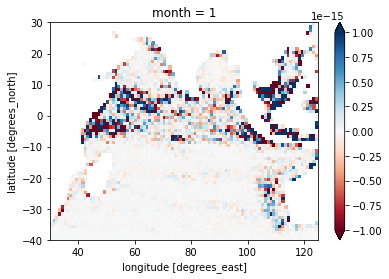

In [53]:
(mua-(eubtb+eubtd+eudtb+eudtd))[0].plot(vmin = -1e-15, vmax = 1e-15, cmap = 'RdBu')


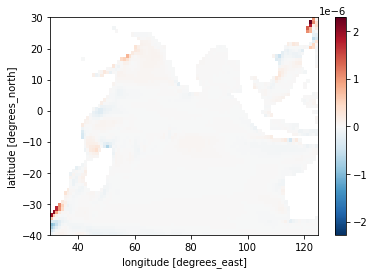

In [22]:
eubtb.plot()

Text(0.5, 1.0, ' GODAS Uadv - sum(u terms), JAN')

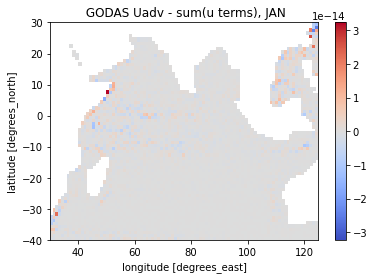

In [30]:
(gua-(gubtb+gubtd+gudtb+gudtd))[0].plot(cmap = 'coolwarm')
plt.title(' GODAS Uadv - sum(u terms), JAN')

In [43]:
#lets extract data from one point
def get_region(DS):
    setio = DS.sel(lat=slice(-8),lon=slice(67)).mean(['lat', 'lon'])
    return setio

Text(0.5, 1.0, 'EC-Earth3; 8S, 67E')

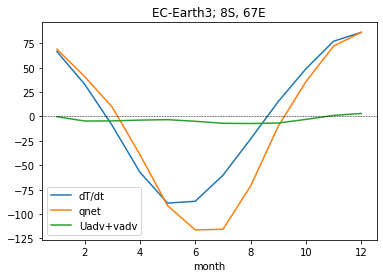

In [44]:
plt.figure()
get_region(mT*(3986*1026*50)).plot(label = 'dT/dt')
get_region(mq*(3986*1026*50)).plot(label = 'qnet')
get_region((mua+mva)*(3986*1026*50)).plot(label = 'Uadv+vadv')
plt.axhline(0, c = 'k', ls = '--', lw = 0.5)
plt.legend()
plt.title('EC-Earth3; 8S, 67E')

Text(0.5, 1.0, 'GODAS; 8S, 67E')

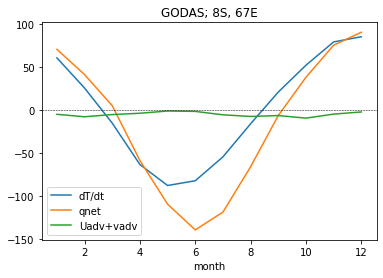

In [45]:
plt.figure()
get_region(gT*(3986*1026*50)).plot(label = 'dT/dt')
get_region(gq*(3986*1026*50)).plot(label = 'qnet')
get_region((gua+gva)*(3986*1026*50)).plot(label = 'Uadv+vadv')
plt.axhline(0, c = 'k', ls = '--', lw = 0.5)
plt.legend()
plt.title('GODAS; 8S, 67E')

Text(0.5, 1.0, 'EC-Earth3 advection; 8S, 67E')

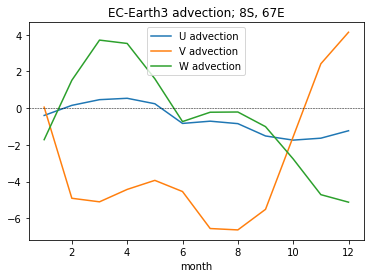

In [46]:
plt.figure()
get_region(mua*(3986*1026*50)).plot(label = 'U advection')
get_region(mva*(3986*1026*50)).plot(label = 'V advection')
get_region(mwa*(3986*1026*50)).plot(label = 'W advection')
plt.axhline(0, c = 'k', ls = '--', lw = 0.5)
plt.legend()
plt.title('EC-Earth3 advection; 8S, 67E')

Text(0.5, 1.0, 'GODAS advection; 8S, 67E')

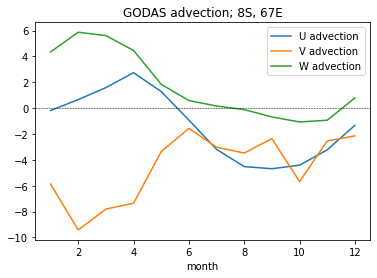

In [47]:
plt.figure()
get_region(gua*(3986*1026*50)).plot(label = 'U advection')
get_region(gva*(3986*1026*50)).plot(label = 'V advection')
get_region(gwa*(3986*1026*50)).plot(label = 'W advection')
plt.axhline(0, c = 'k', ls = '--', lw = 0.5)
plt.legend()
plt.title('GODAS advection; 8S, 67E')

Text(0.5, 1.0, 'EC-Earth3 U advection (mean vs eddy) \n 8S, 67E')

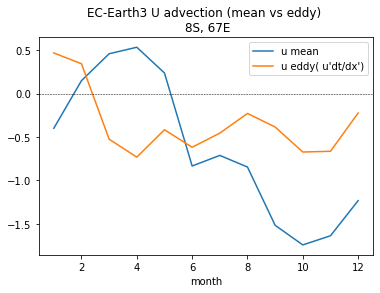

In [48]:
plt.figure()
get_region(mua*(3986*1026*50)).plot(label = 'u mean')
get_region(eudtd*(3986*1026*50)).plot(label = "u eddy( u'dt/dx')")
plt.axhline(0, c = 'k', ls = '--', lw = 0.5)
plt.legend()
plt.title('EC-Earth3 U advection (mean vs eddy) \n 8S, 67E')

Text(0.5, 1.0, 'EC-Earth3 V advection (mean vs eddy) \n 8S, 67E')

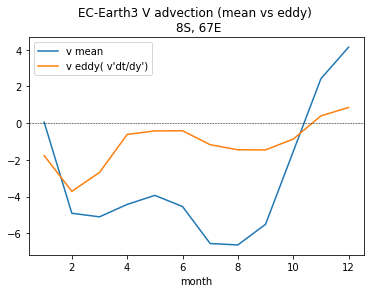

In [49]:
plt.figure()
get_region(mva*(3986*1026*50)).plot(label = 'v mean')
get_region(evdtd*(3986*1026*50)).plot(label = "v eddy( v'dt/dy')")
plt.axhline(0, c = 'k', ls = '--', lw = 0.5)
plt.legend()
plt.title('EC-Earth3 V advection (mean vs eddy) \n 8S, 67E')

Text(0.5, 1.0, 'GODAS U advection (mean vs eddy) \n 8S, 67E')

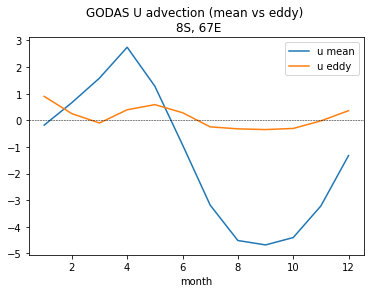

In [50]:
plt.figure()
get_region(gua*(3986*1026*50)).plot(label = 'u mean')
get_region(gudtd*(3986*1026*50)).plot(label = 'u eddy')
plt.axhline(0, c = 'k', ls = '--', lw = 0.5)
plt.legend()
plt.title('GODAS U advection (mean vs eddy) \n 8S, 67E')

Text(0.5, 1.0, 'GODAS V advection (mean vs eddy) \n 8S, 67E')

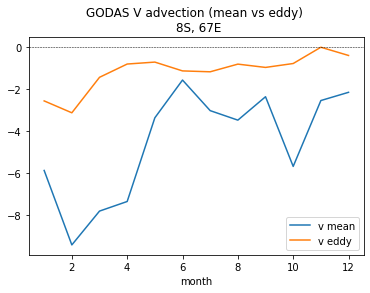

In [51]:
plt.figure()
get_region(gva*(3986*1026*50)).plot(label = 'v mean')
get_region(gvdtd*(3986*1026*50)).plot(label = 'v eddy')
plt.axhline(0, c = 'k', ls = '--', lw = 0.5)
plt.legend()
plt.title('GODAS V advection (mean vs eddy) \n 8S, 67E')

Text(0.5, 1.0, 'EC-Earth3 Resdidual')

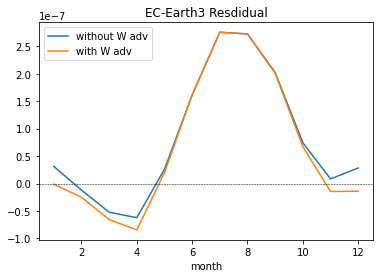

In [42]:
plt.figure()
get_region(mT-mq+mua+mva).plot(label = 'without W adv')
get_region(mT-mq+mua+mva+mwa).plot(label = 'with W adv')
plt.axhline(0, c = 'k', ls = '--', lw = 0.5)
plt.legend()
plt.title('EC-Earth3 Resdidual')


Text(0.5, 1.0, 'GODAS Resdidual')

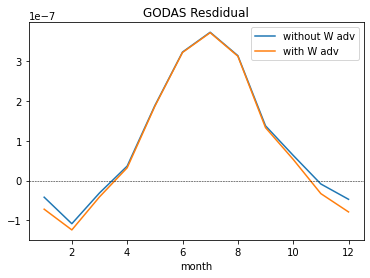

In [34]:
plt.figure()
get_region(gT-gq+gua+gva).plot(label = 'without W adv')
get_region(gT-gq+gua+gva+gwa).plot(label = 'with W adv')
plt.axhline(0, c = 'k', ls = '--', lw = 0.5)
plt.legend()
plt.title('GODAS Resdidual')

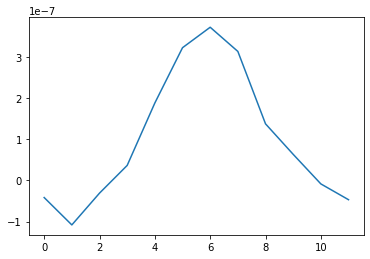

In [136]:
plt.figure()
plt.plot(get_region(gT-gq+gua+gva))

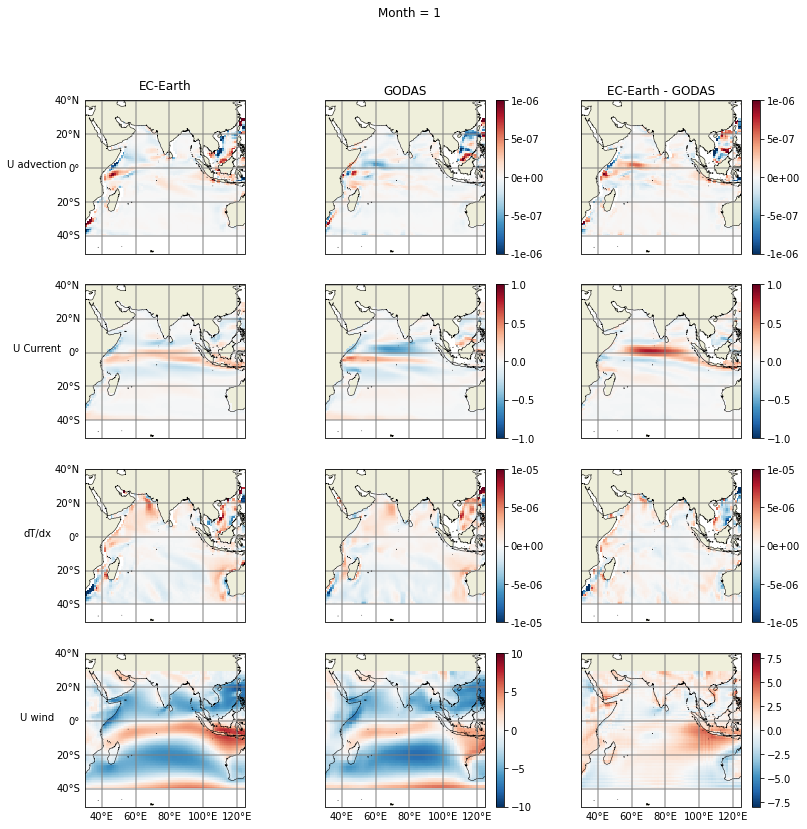

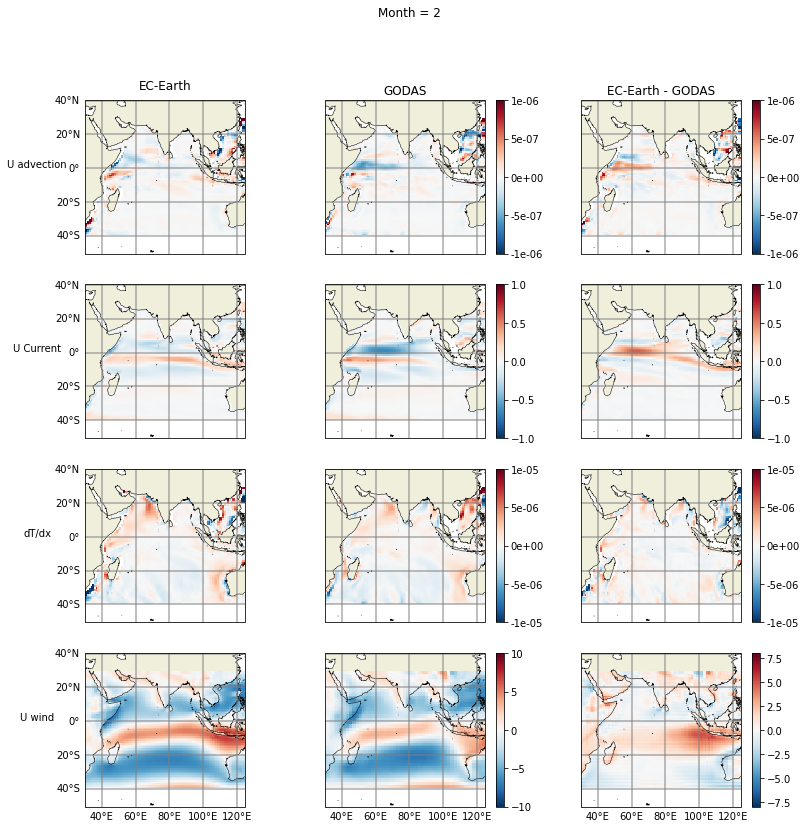

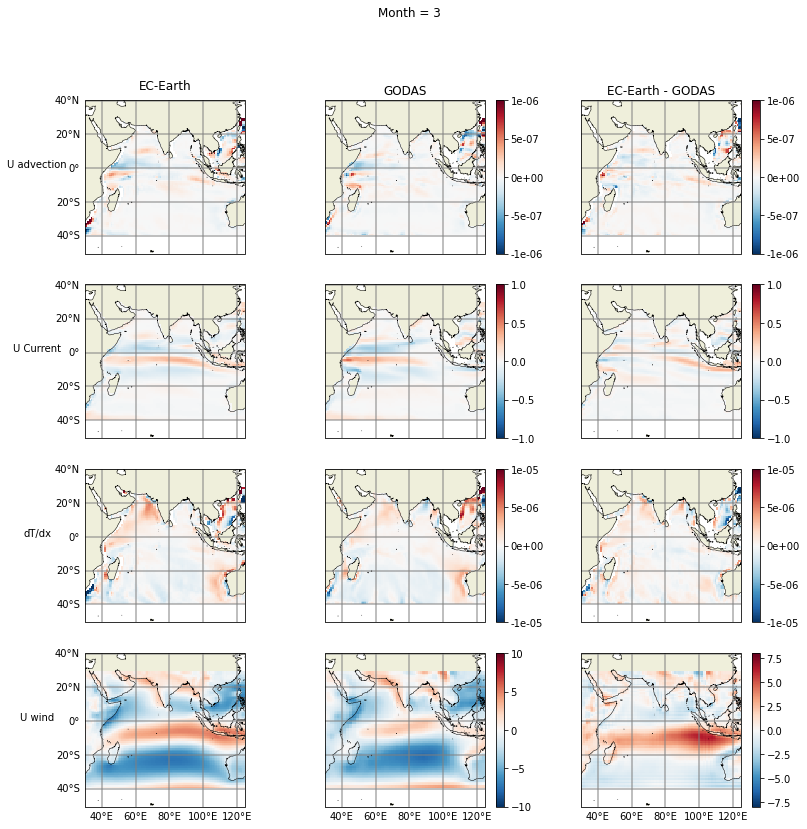

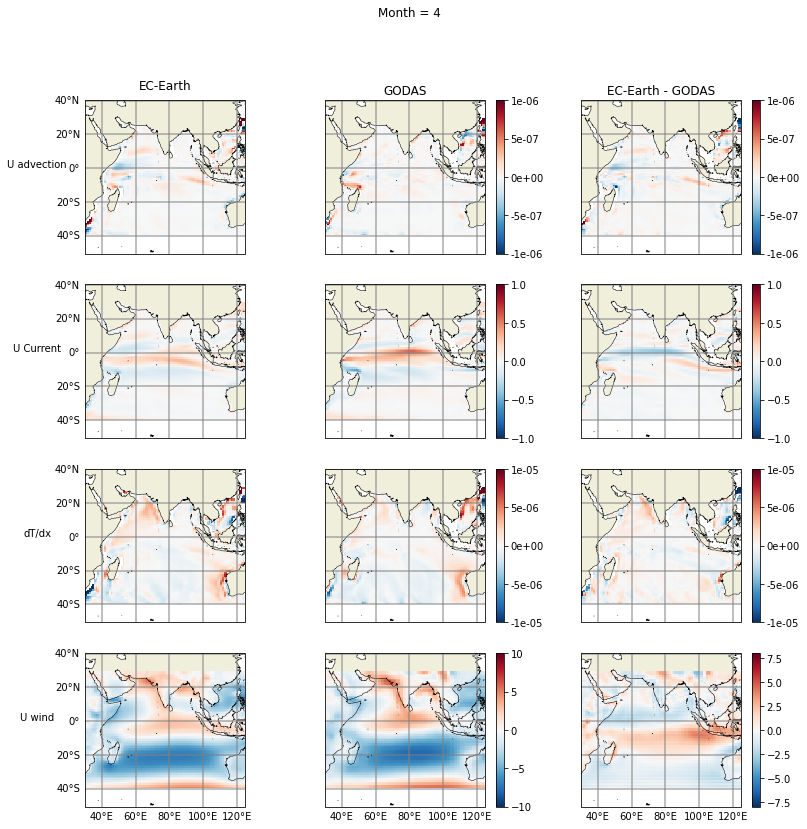

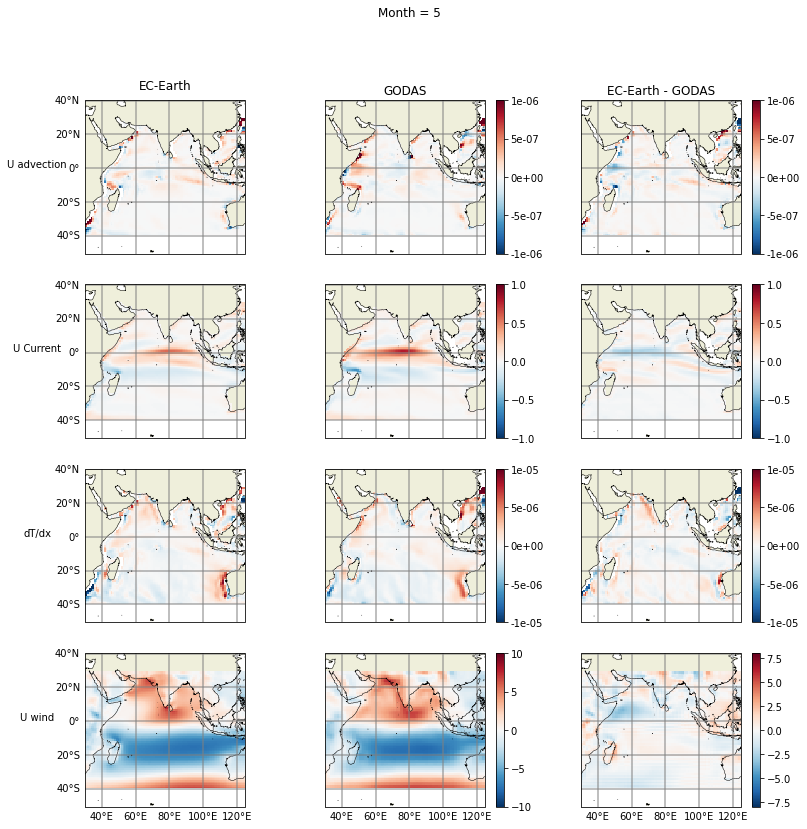

...

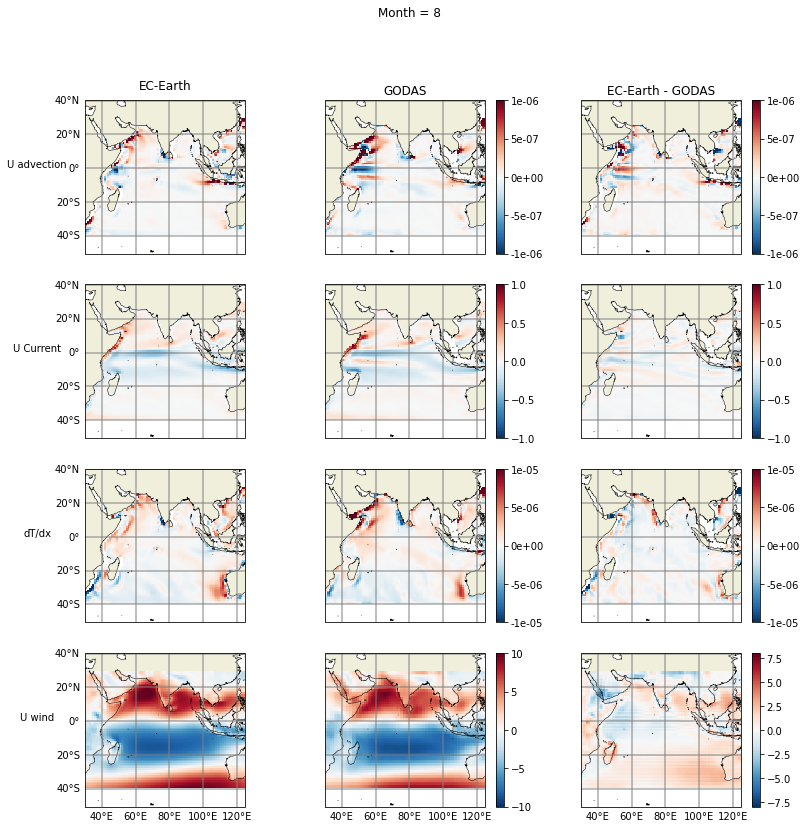

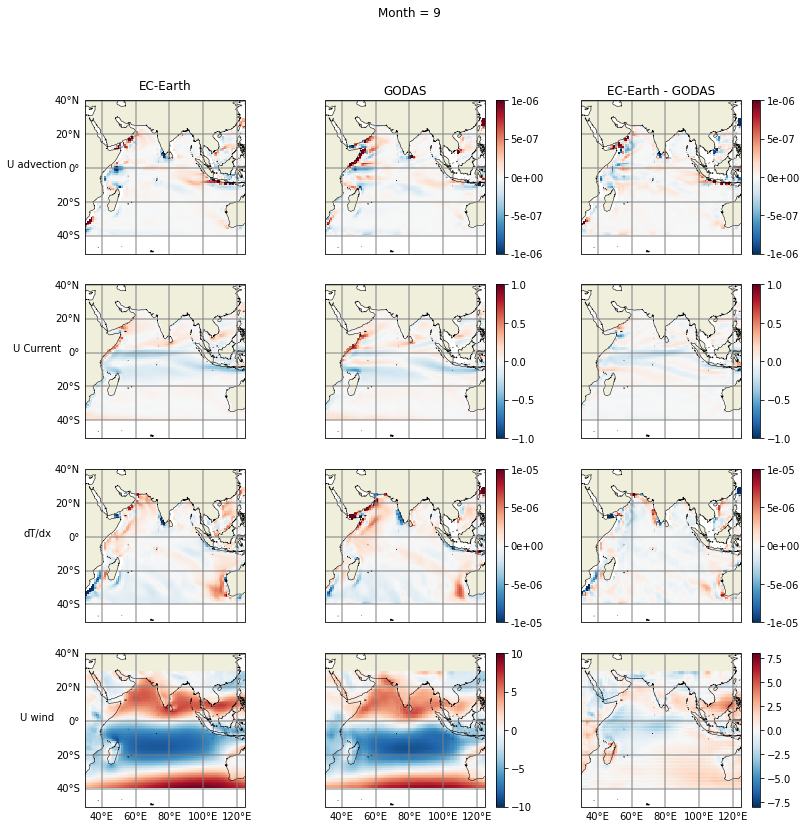

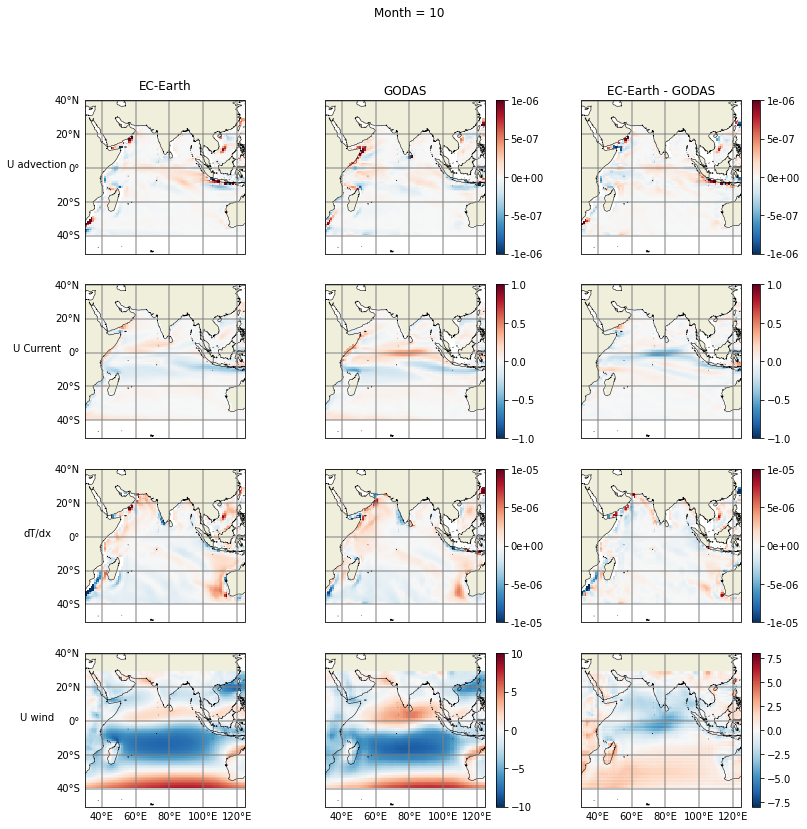

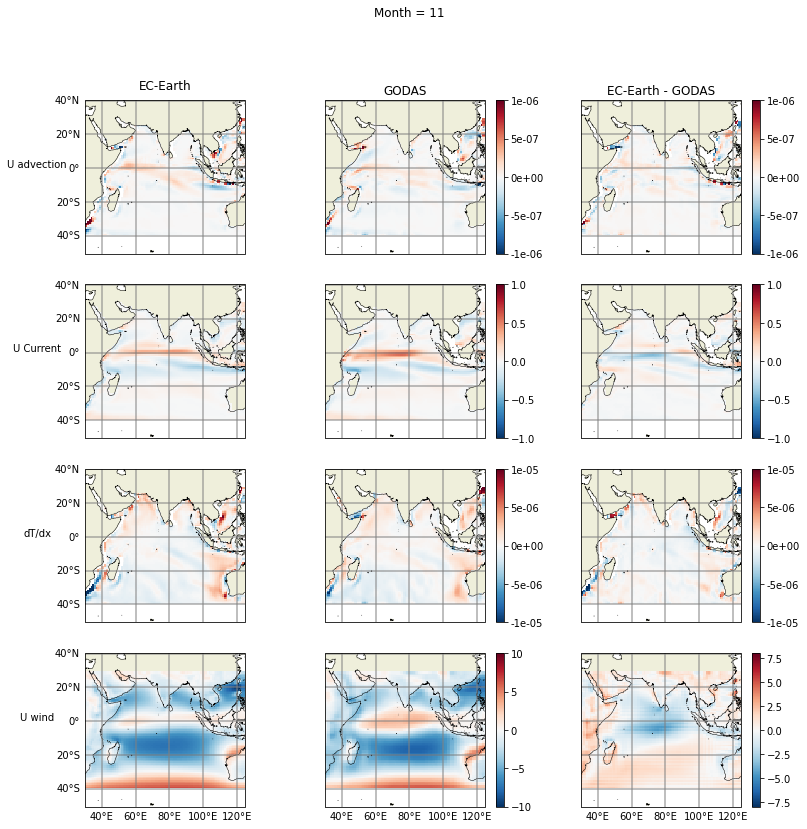

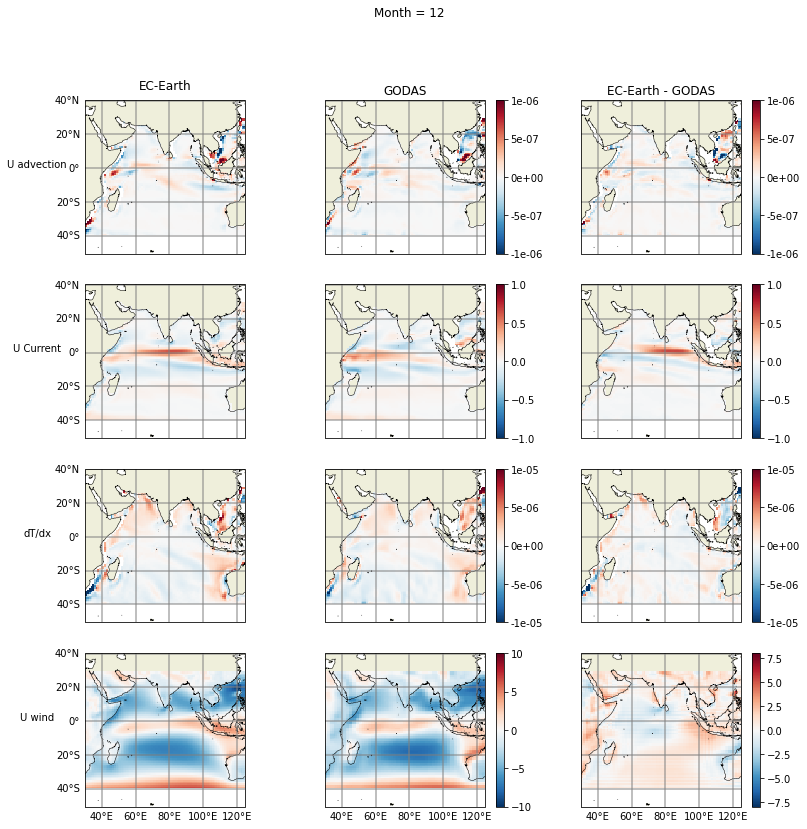

In [12]:
for i in range(0,12):
    fig, axes = plt.subplots(nrows=4, ncols=3, figsize=(13, 13), sharey='all', sharex='all', 
                             subplot_kw={'projection':ccrs.PlateCarree()})
    mon = i+1
    fig.suptitle('Month = '+str(mon))
    #plot  advection term
    axes[0, 0].pcolormesh(lons, lats, mua.sel(month = i+1), cmap = 'RdBu_r', 
                                vmin = -1E-6, vmax = 1E-6, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[0,0], 0, 0)
    axes[0,0].text(-0.3, 0.55, 'U advection', va='bottom', ha='center',
        rotation='horizontal', rotation_mode='anchor',
        transform=axes[0,0].transAxes)
    im = axes[0, 1].pcolormesh(lons, lats, gua.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -1e-6, vmax = 1e-6, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[0,1], 0, 1)    
    fig.colorbar(im, ax = axes[0,1],format='%.0e')
    #plot difference
    im = axes[0, 2].pcolormesh(lons, lats, dua.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -1e-6, vmax = 1e-6, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[0,2], 0, 2)    
    fig.colorbar(im, ax = axes[0,2],format='%.0e')
    axes[0,0].set_title('EC-Earth')
    axes[0,1].set_title('GODAS')
    axes[0,2].set_title('EC-Earth - GODAS')
    
    ###############################################################################################
    #plot same for current
    axes[1, 0].pcolormesh(lons, lats, muc.sel(month = i+1), cmap = 'RdBu_r', 
                                vmin = -1, vmax = 1, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[1,0], 1, 0)
    axes[1,0].text(-0.3, 0.55, 'U Current', va='bottom', ha='center',
        rotation='horizontal', rotation_mode='anchor',
        transform=axes[1,0].transAxes)
    im = axes[1, 1].pcolormesh(lons, lats, guc.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -1, vmax = 1, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[1,1], 1, 1)    
    fig.colorbar(im, ax = axes[1,1])
    #plot difference
    im = axes[1, 2].pcolormesh(lons, lats, duc.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -1, vmax = 1, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[1,2], 1, 2)    
    fig.colorbar(im, ax = axes[1,2])    
    ##############################################################################################
    #same for temp gradient
    axes[2, 0].pcolormesh(lons, lats, mdx.sel(month = i+1), cmap = 'RdBu_r', 
                                vmin = -1E-5, vmax = 1E-5, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[2,0], 2, 0)
    axes[2,0].text(-0.3, 0.55, 'dT/dx', va='bottom', ha='center',
        rotation='horizontal', rotation_mode='anchor',
        transform=axes[2,0].transAxes)
    im = axes[2, 1].pcolormesh(lons, lats, gdx.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -1e-5, vmax = 1e-5, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[2,1],2, 1)    
    fig.colorbar(im, ax = axes[2,1],format='%.0e')
    #plot difference
    im = axes[2, 2].pcolormesh(lons, lats, ddx.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -1e-5, vmax = 1e-5, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[2,2], 2, 2)    
    fig.colorbar(im, ax = axes[2,2],format='%.0e')    
    #same for u wind
    ##############################################################################################    
    axes[3, 0].pcolormesh(lons, lats, muw.sel(month = i+1), cmap = 'RdBu_r', 
                                vmin = -10, vmax = 10, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[3,0], 3, 0)
    axes[3,0].text(-0.3, 0.55, 'U wind', va='bottom', ha='center',
        rotation='horizontal', rotation_mode='anchor',
        transform=axes[3,0].transAxes)
    im = axes[3, 1].pcolormesh(lons, lats, guw[:,0].sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -10, vmax = 10, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[3,1], 3, 1)    
    fig.colorbar(im, ax = axes[3,1], )
    #plot difference
    im = axes[3, 2].pcolormesh(lons, lats, duw.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -8, vmax = 8, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[3,2], 3, 2)    
    fig.colorbar(im, ax = axes[3,2])
    fig.savefig('/home/561/sm2435/Documents/figures/U_terms_'+str(mon)+'.png', dpi = 300, bbox_inches='tight')

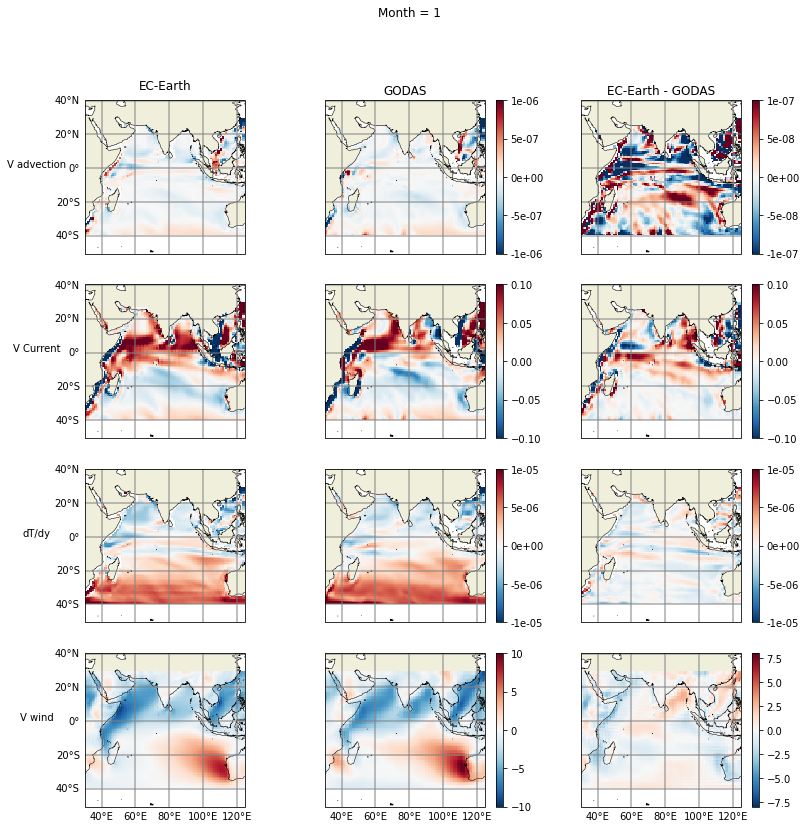

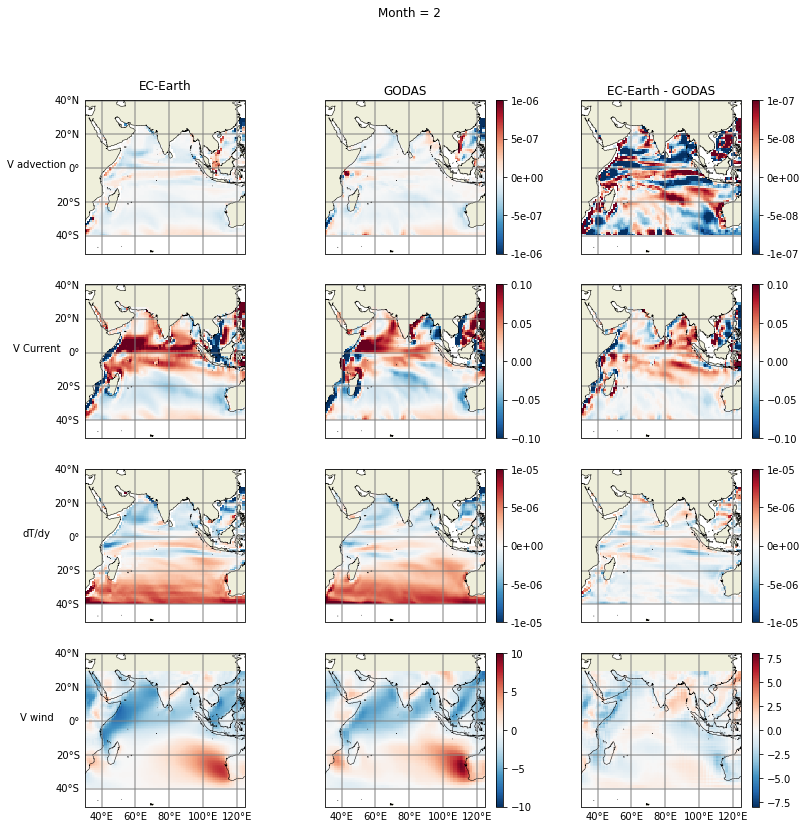

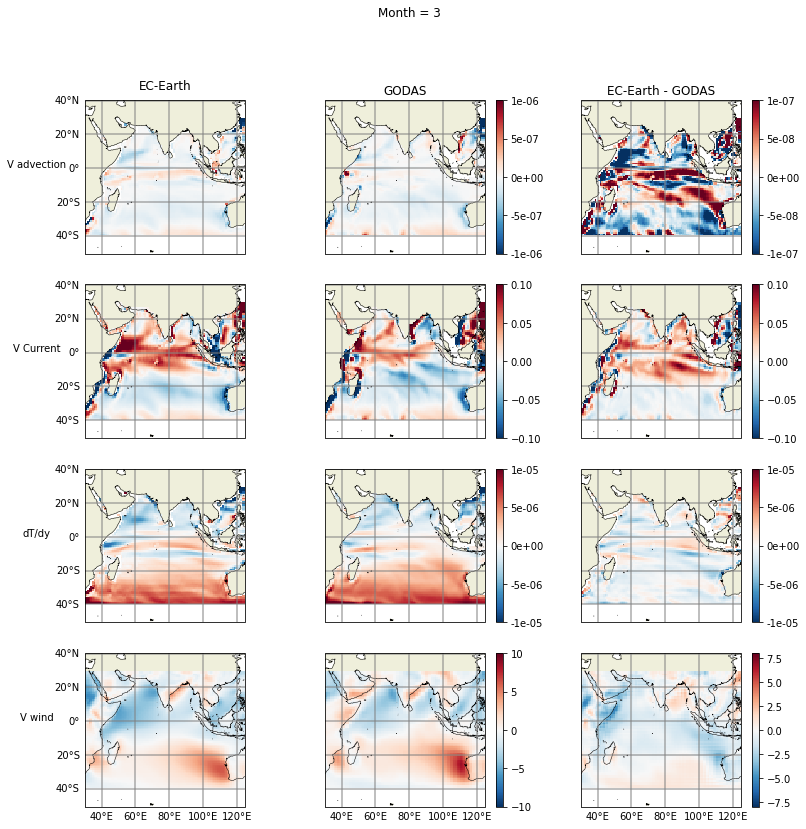

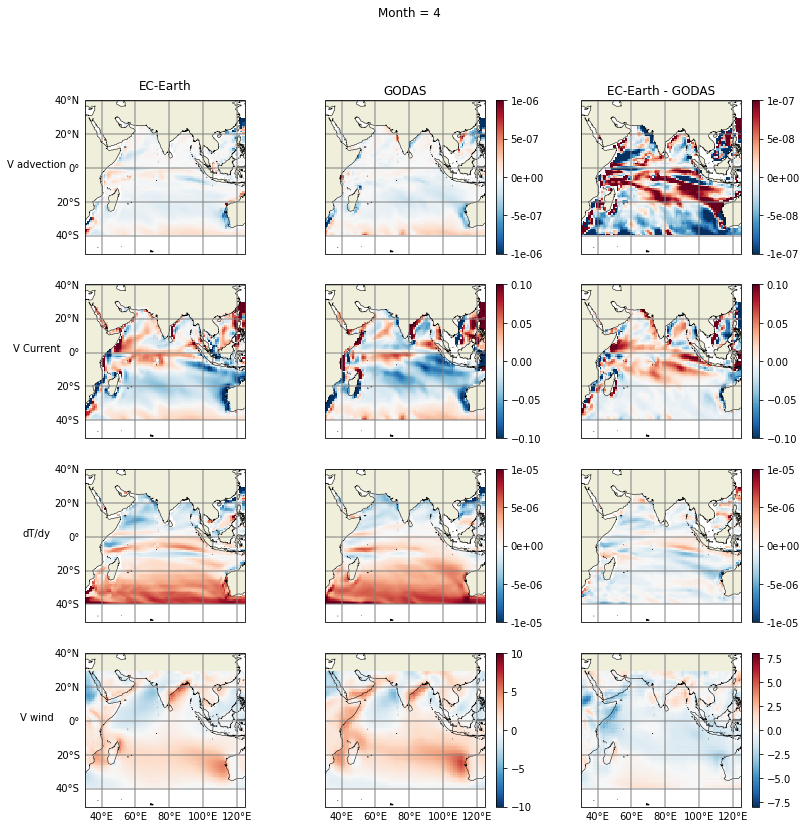

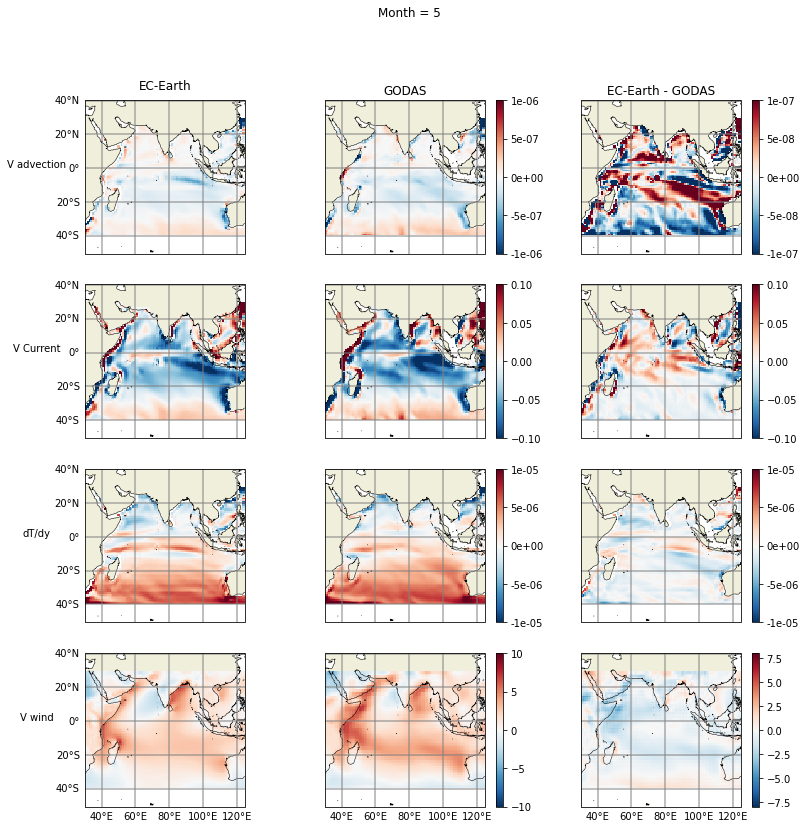

...

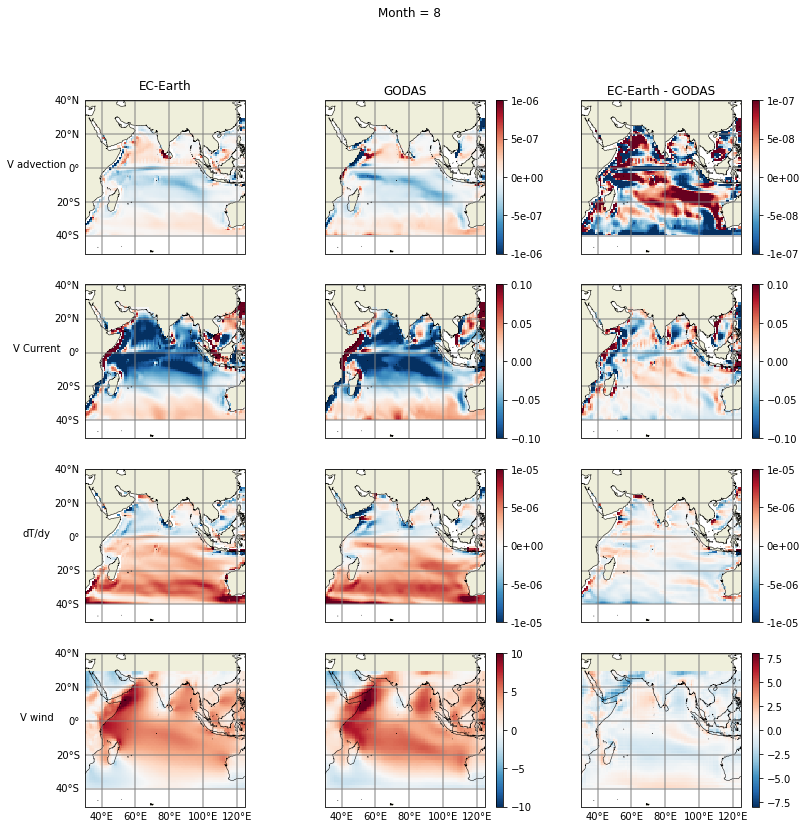

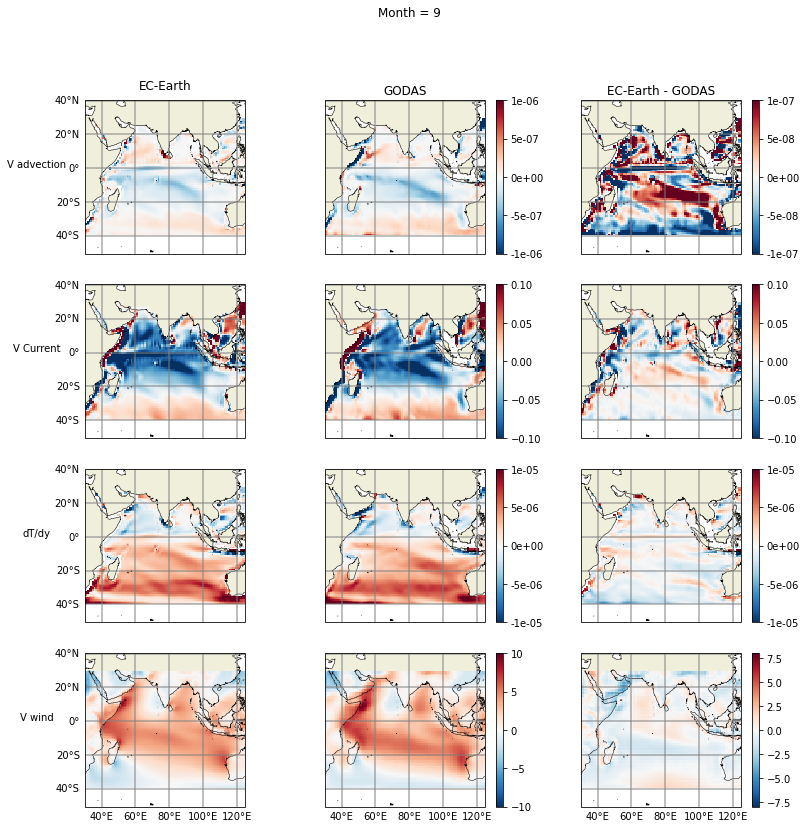

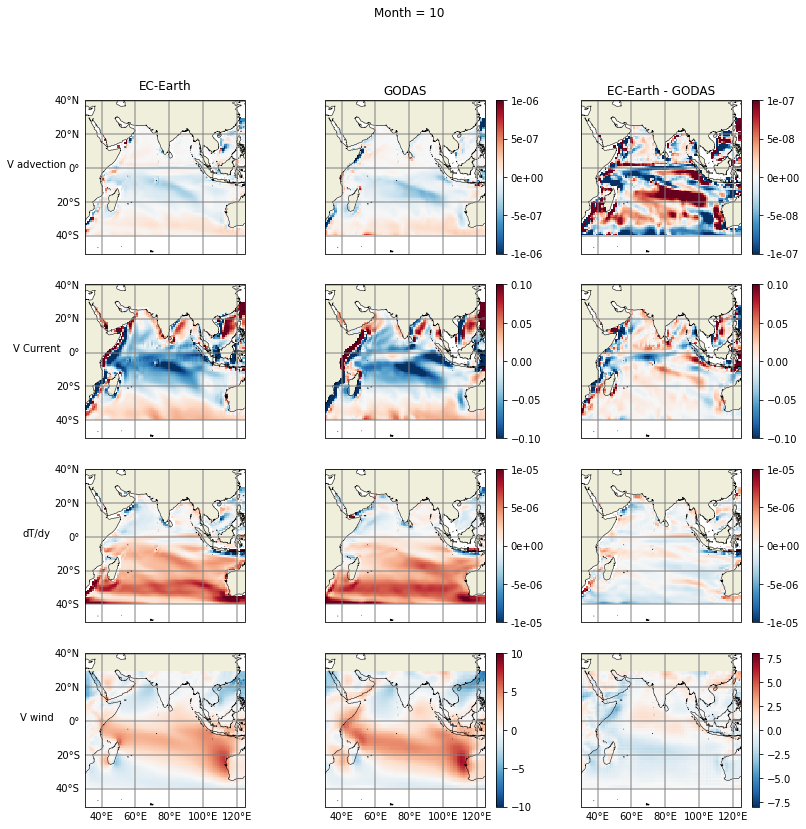

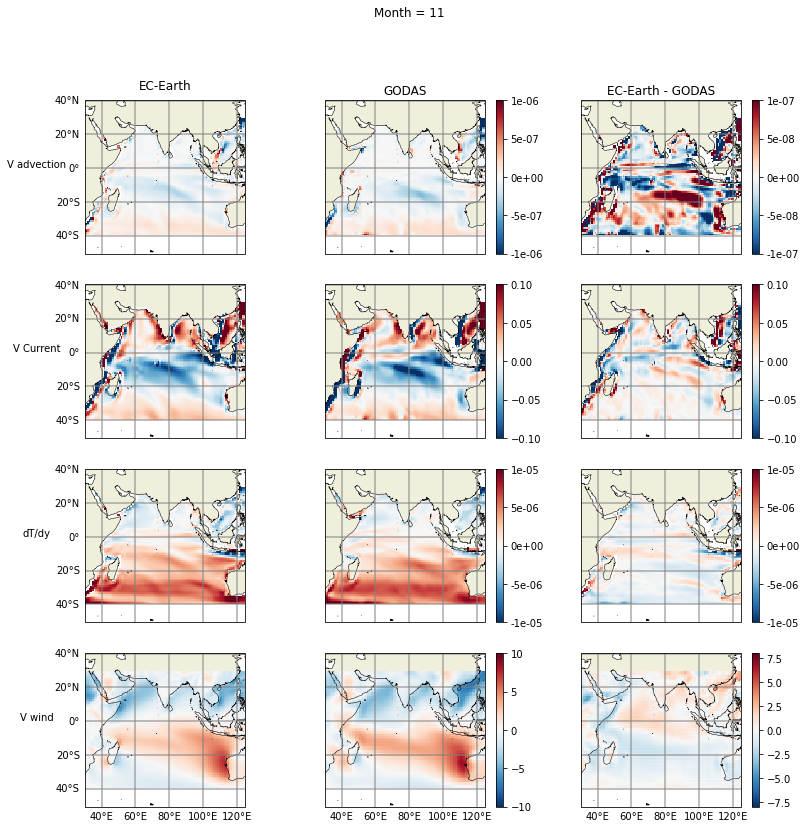

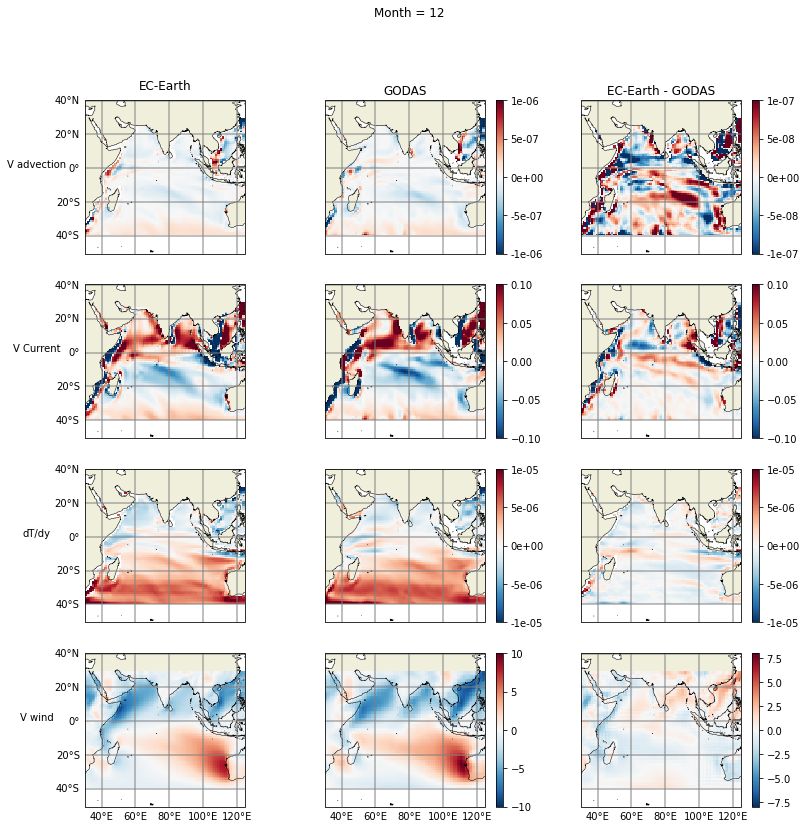

In [13]:
for i in range(0,12):
    fig, axes = plt.subplots(nrows=4, ncols=3, figsize=(13, 13), sharey='all', sharex='all', 
                             subplot_kw={'projection':ccrs.PlateCarree()})
    mon = i+1
    fig.suptitle('Month = '+str(mon))
    #plot  advection term
    axes[0, 0].pcolormesh(lons, lats, mva.sel(month = i+1), cmap = 'RdBu_r', 
                                vmin = -1E-6, vmax = 1E-6, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[0,0], 0, 0)
    axes[0,0].text(-0.3, 0.55, 'V advection', va='bottom', ha='center',
        rotation='horizontal', rotation_mode='anchor',
        transform=axes[0,0].transAxes)
    im = axes[0, 1].pcolormesh(lons, lats, gva.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -1e-6, vmax = 1e-6, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[0,1], 0, 1)    
    fig.colorbar(im, ax = axes[0,1],format='%.0e')
    #plot difference
    im = axes[0, 2].pcolormesh(lons, lats, dva.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -1e-7, vmax = 1e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[0,2], 0, 2)    
    fig.colorbar(im, ax = axes[0,2],format='%.0e')
    axes[0,0].set_title('EC-Earth')
    axes[0,1].set_title('GODAS')
    axes[0,2].set_title('EC-Earth - GODAS')
    
    ###############################################################################################
    #plot same for current
    axes[1, 0].pcolormesh(lons, lats, mvc.sel(month = i+1), cmap = 'RdBu_r', 
                                vmin = -0.1, vmax = 0.1, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[1,0], 1, 0)
    axes[1,0].text(-0.3, 0.55, 'V Current', va='bottom', ha='center',
        rotation='horizontal', rotation_mode='anchor',
        transform=axes[1,0].transAxes)
    im = axes[1, 1].pcolormesh(lons, lats, gvc.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -0.1, vmax = 0.1, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[1,1], 1, 1)    
    fig.colorbar(im, ax = axes[1,1])
    #plot difference
    im = axes[1, 2].pcolormesh(lons, lats, dvc.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -0.1, vmax = 0.1, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[1,2], 1, 2)    
    fig.colorbar(im, ax = axes[1,2])    
    ##############################################################################################
    #same for temp gradient
    axes[2, 0].pcolormesh(lons, lats, mdy.sel(month = i+1), cmap = 'RdBu_r', 
                                vmin = -1E-5, vmax = 1E-5, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[2,0], 2, 0)
    axes[2,0].text(-0.3, 0.55, 'dT/dy', va='bottom', ha='center',
        rotation='horizontal', rotation_mode='anchor',
        transform=axes[2,0].transAxes)
    im = axes[2, 1].pcolormesh(lons, lats, gdy.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -1e-5, vmax = 1e-5, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[2,1],2, 1)    
    fig.colorbar(im, ax = axes[2,1],format='%.0e')
    #plot difference
    im = axes[2, 2].pcolormesh(lons, lats, ddy.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -1e-5, vmax = 1e-5, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[2,2], 2, 2)    
    fig.colorbar(im, ax = axes[2,2],format='%.0e')    
    #same for u wind
    ##############################################################################################    
    axes[3, 0].pcolormesh(lons, lats, mvw.sel(month = i+1), cmap = 'RdBu_r', 
                                vmin = -10, vmax = 10, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[3,0], 3, 0)
    axes[3,0].text(-0.3, 0.55, 'V wind', va='bottom', ha='center',
        rotation='horizontal', rotation_mode='anchor',
        transform=axes[3,0].transAxes)
    im = axes[3, 1].pcolormesh(lons, lats, gvw[:,0].sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -10, vmax = 10, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[3,1], 3, 1)    
    fig.colorbar(im, ax = axes[3,1], )
    #plot difference
    im = axes[3, 2].pcolormesh(lons, lats, dvw.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -8, vmax = 8, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[3,2], 3, 2)    
    fig.colorbar(im, ax = axes[3,2])
    fig.savefig('/home/561/sm2435/Documents/figures/V_terms_'+str(mon)+'.png', dpi = 300, bbox_inches='tight')

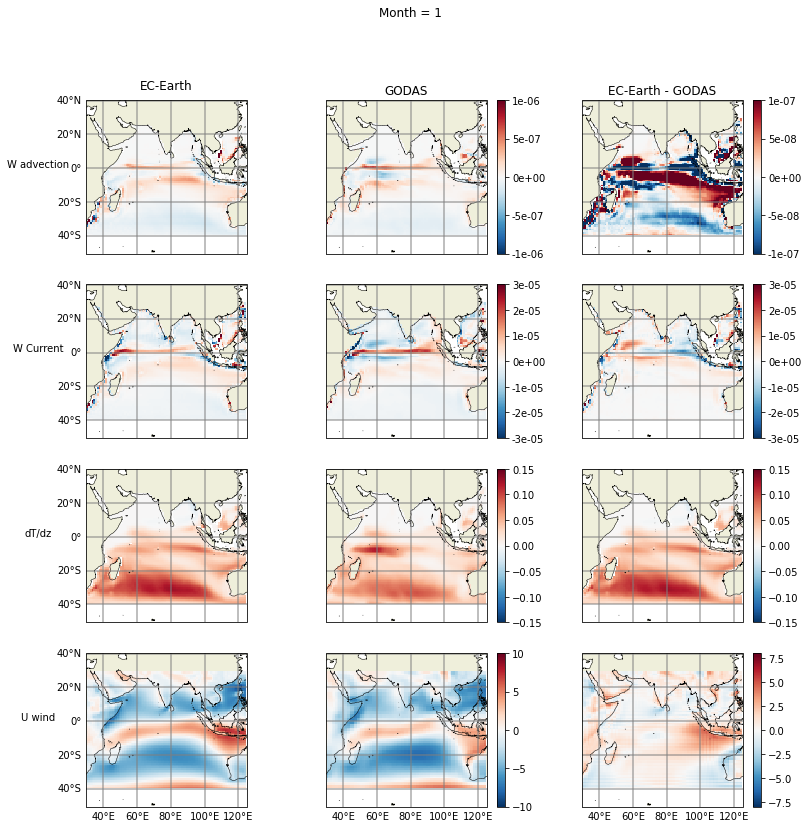

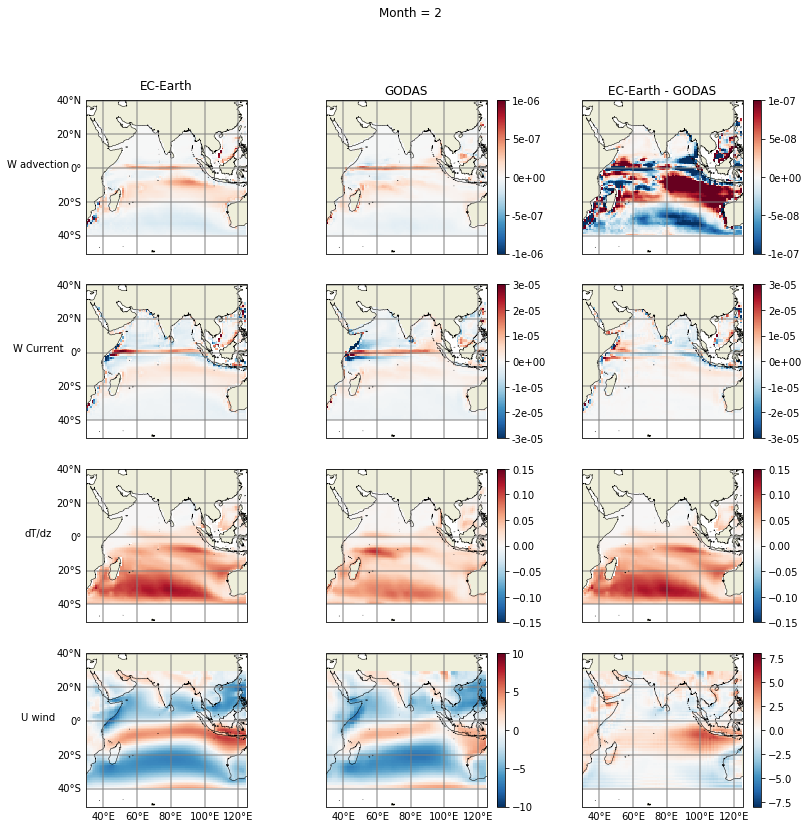

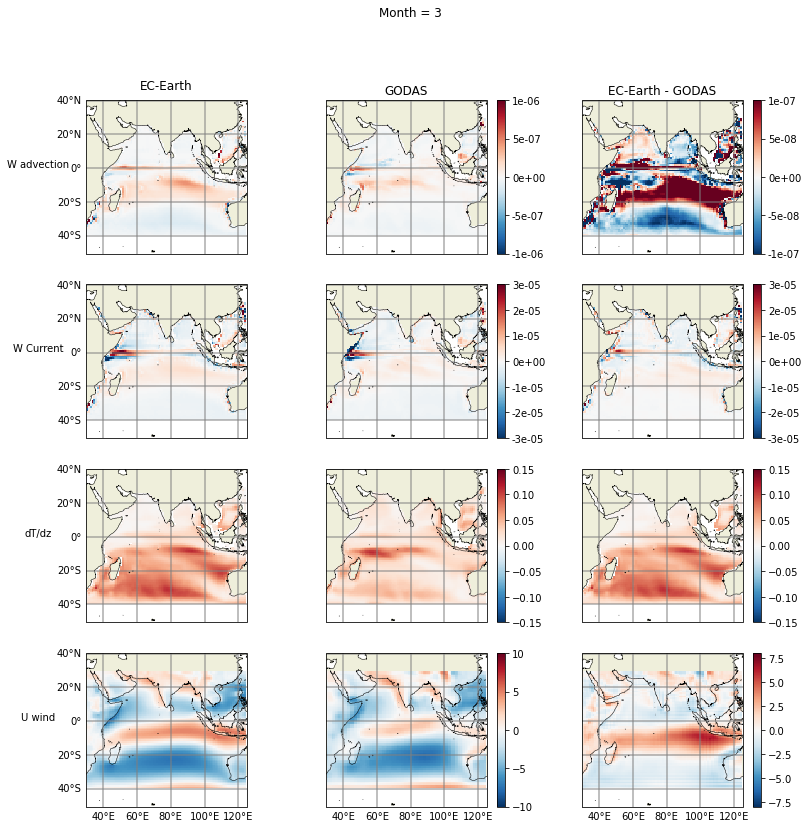

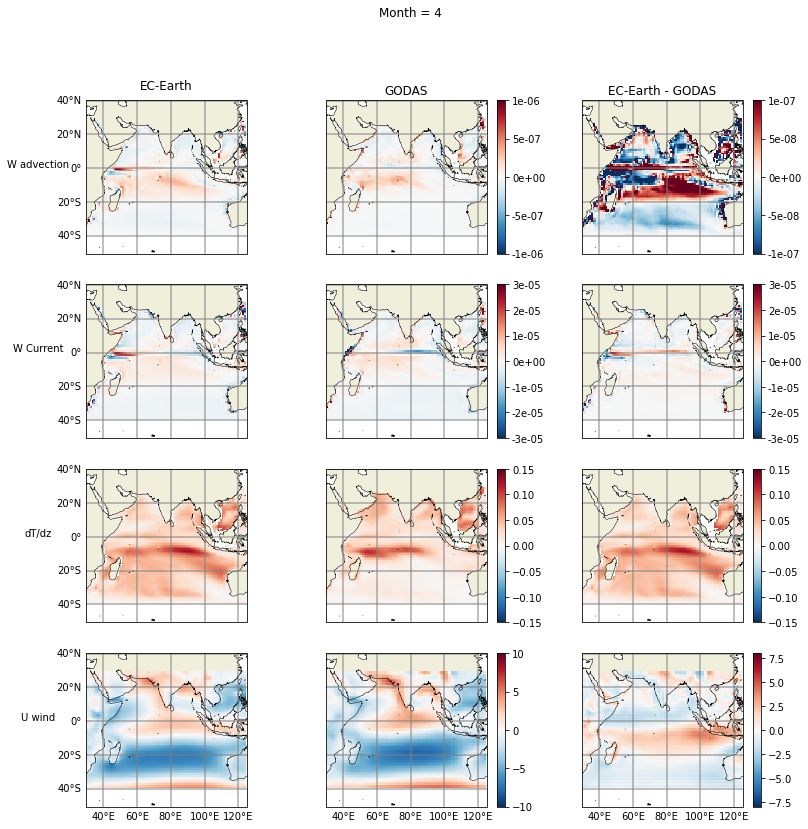

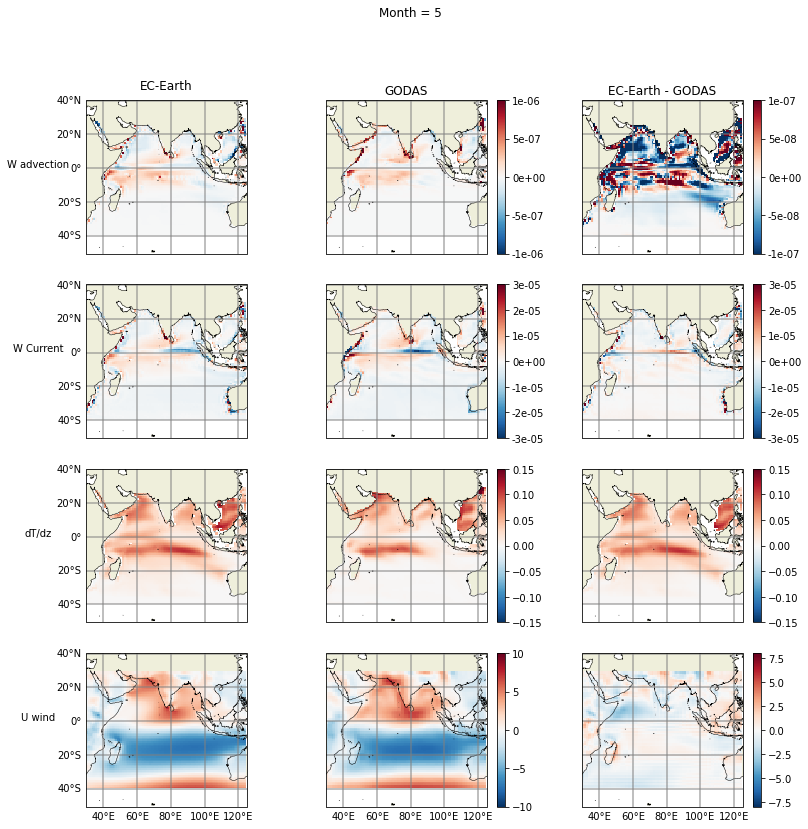

...

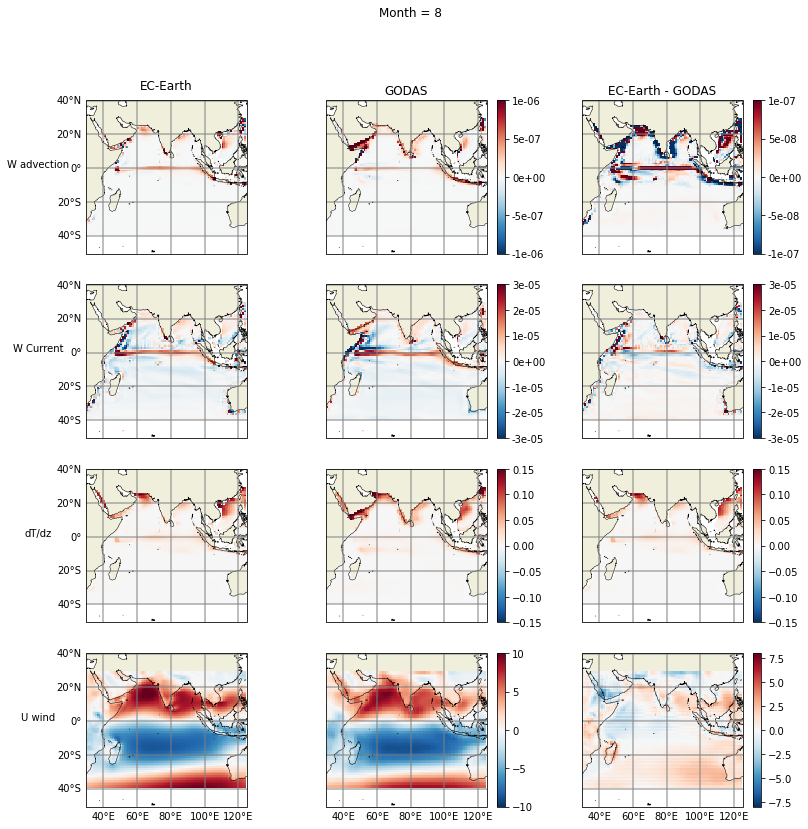

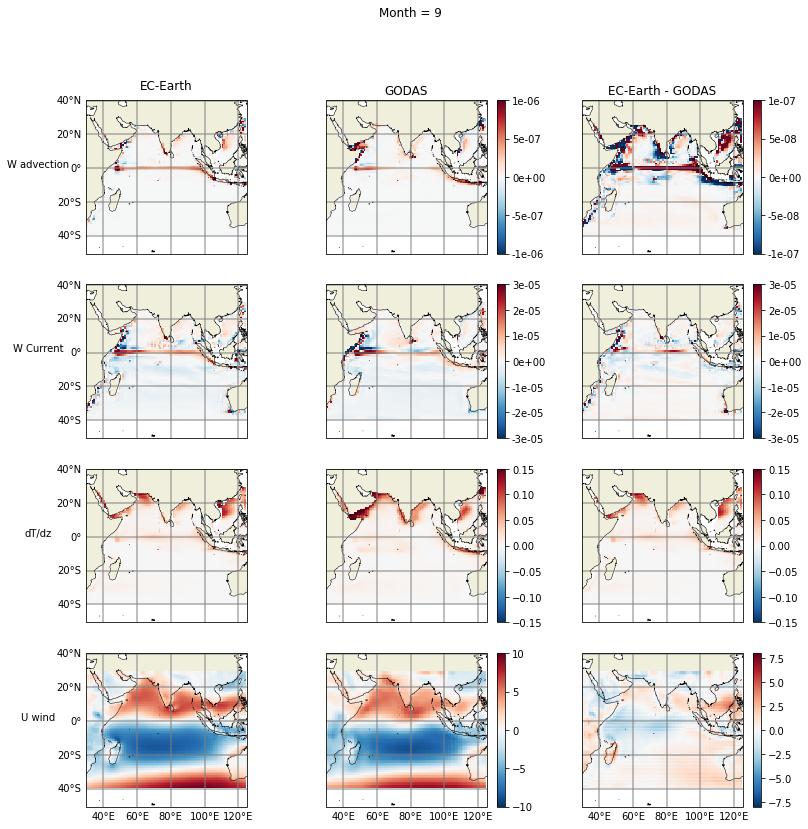

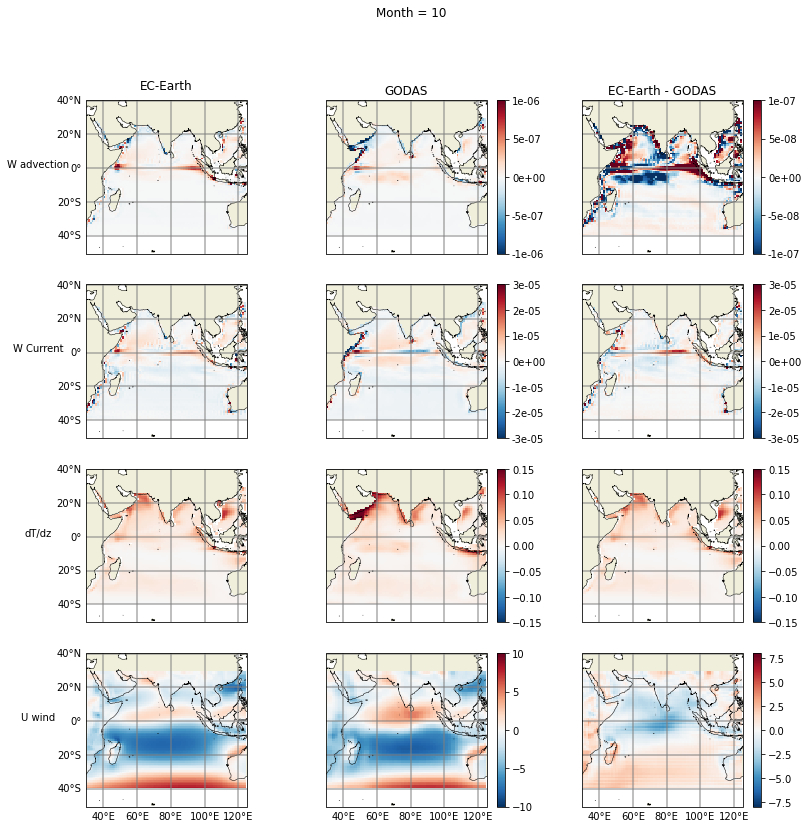

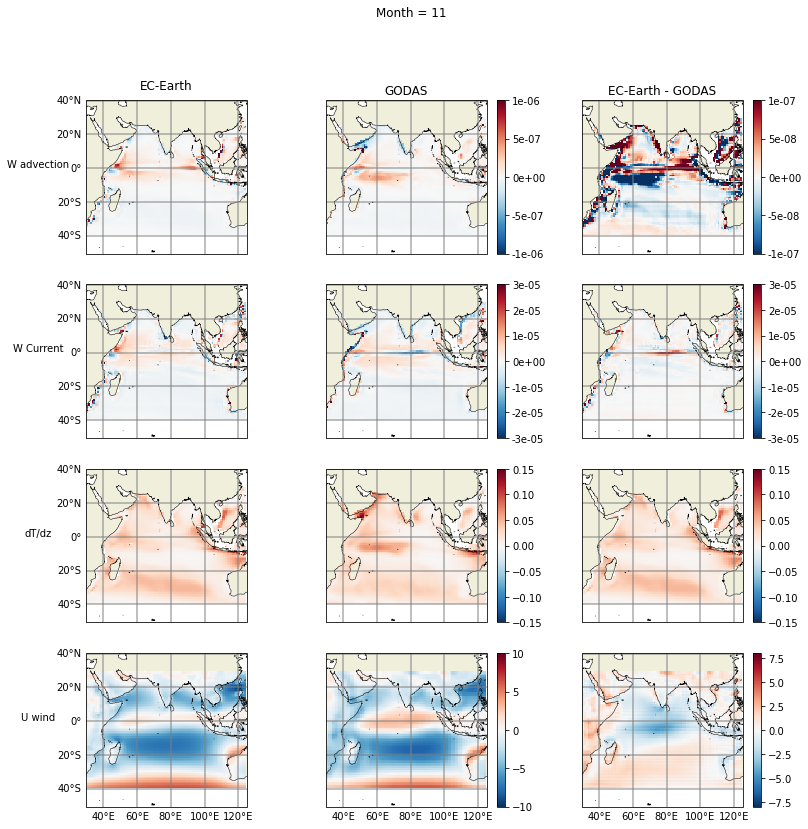

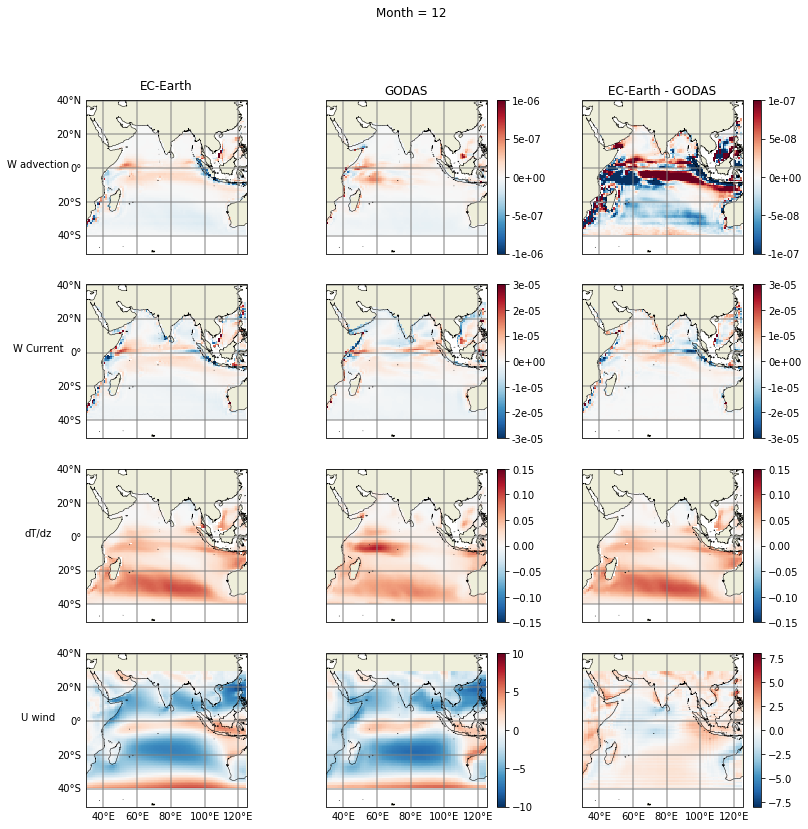

In [14]:
for i in range(0,12):
    fig, axes = plt.subplots(nrows=4, ncols=3, figsize=(13, 13), sharey='all', sharex='all', 
                             subplot_kw={'projection':ccrs.PlateCarree()})
    mon = i+1
    fig.suptitle('Month = '+str(mon))
    #plot  advection term
    axes[0, 0].pcolormesh(lons, lats, mwa.sel(month = i+1), cmap = 'RdBu_r', 
                                vmin = -1E-6, vmax = 1E-6, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[0,0], 0, 0)
    axes[0,0].text(-0.3, 0.55, 'W advection', va='bottom', ha='center',
        rotation='horizontal', rotation_mode='anchor',
        transform=axes[0,0].transAxes)
    im = axes[0, 1].pcolormesh(lons, lats, gwa.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -1e-6, vmax = 1e-6, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[0,1], 0, 1)    
    fig.colorbar(im, ax = axes[0,1],format='%.0e')
    #plot difference
    im = axes[0, 2].pcolormesh(lons, lats, dwa.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -1e-7, vmax = 1e-7, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[0,2], 0, 2)    
    fig.colorbar(im, ax = axes[0,2],format='%.0e')
    axes[0,0].set_title('EC-Earth')
    axes[0,1].set_title('GODAS')
    axes[0,2].set_title('EC-Earth - GODAS')
    
    ###############################################################################################
    #plot same for current
    axes[1, 0].pcolormesh(lons, lats, mwc.sel(month = i+1), cmap = 'RdBu_r', 
                                vmin = -3e-5, vmax = 3e-5, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[1,0], 1, 0)
    axes[1,0].text(-0.3, 0.55, 'W Current', va='bottom', ha='center',
        rotation='horizontal', rotation_mode='anchor',
        transform=axes[1,0].transAxes)
    im = axes[1, 1].pcolormesh(lons, lats, gwc.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -3e-5, vmax = 3e-5, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[1,1], 1, 1)    
    fig.colorbar(im, ax = axes[1,1],format='%.0e')
    #plot difference
    im = axes[1, 2].pcolormesh(lons, lats, dwc.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -3e-5, vmax = 3e-5, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[1,2], 1, 2)    
    fig.colorbar(im, ax = axes[1,2],format='%.0e')    
    ##############################################################################################
    #same for temp gradient
    axes[2, 0].pcolormesh(lons, lats, mdz.sel(month = i+1), cmap = 'RdBu_r', 
                                vmin = -0.15, vmax = 0.15, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[2,0], 2, 0)
    axes[2,0].text(-0.3, 0.55, 'dT/dz', va='bottom', ha='center',
        rotation='horizontal', rotation_mode='anchor',
        transform=axes[2,0].transAxes)
    im = axes[2, 1].pcolormesh(lons, lats, gdz.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -0.15, vmax = 0.15, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[2,1],2, 1)    
    fig.colorbar(im, ax = axes[2,1])
    #plot difference
    im = axes[2, 2].pcolormesh(lons, lats, ddz.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -0.15, vmax =0.15, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[2,2], 2, 2)    
    fig.colorbar(im, ax = axes[2,2])    
    #same for u wind
    ##############################################################################################    
    axes[3, 0].pcolormesh(lons, lats, muw.sel(month = i+1), cmap = 'RdBu_r', 
                                vmin = -10, vmax = 10, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[3,0], 3, 0)
    axes[3,0].text(-0.3, 0.55, 'U wind', va='bottom', ha='center',
        rotation='horizontal', rotation_mode='anchor',
        transform=axes[3,0].transAxes)
    im = axes[3, 1].pcolormesh(lons, lats, guw[:,0].sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -10, vmax = 10, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[3,1], 3, 1)    
    fig.colorbar(im, ax = axes[3,1], )
    #plot difference
    im = axes[3, 2].pcolormesh(lons, lats, duw.sel(month = i+1), cmap = 'RdBu_r', 
                                #colorbar=True, 
                                vmin = -8, vmax = 8, 
                                transform=ccrs.PlateCarree())
    plot_background(axes[3,2], 3, 2)    
    fig.colorbar(im, ax = axes[3,2])
    fig.savefig('/home/561/sm2435/Documents/figures/W_terms_'+str(mon)+'.png', dpi = 300, bbox_inches='tight')